In [1]:
import os
import argparse
import time
import glob
import pickle
import subprocess
import shlex
import io
import pprint
import importlib
from urllib.request import urlopen
from IPython.display import Image as dispImg
import scipy.io
import numpy as np
import pandas
import tqdm
import fire
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.utils.model_zoo
import torchvision
from art.classifiers import PyTorchClassifier
import cornet
from art.attacks import BoundaryAttack
from art.attacks import HopSkipJump
from imgaug import augmenters as iaa
import imgaug as ia
#attack = HopSkipJump(classifier=classifier, targeted=False, max_iter=0, max_eval=1000, init_eval=10)
from art.attacks import FastGradientMethod
from art.attacks import ElasticNet

from PIL import Image
Image.warnings.simplefilter('ignore')

ia.seed(1)
np.random.seed(0)
torch.manual_seed(0)

mean = torch.tensor([0.44, 0.44, 0.44], dtype=torch.float32)
std = torch.tensor([0.225, 0.225, 0.225], dtype=torch.float32)
normalize = torchvision.transforms.Normalize(mean=[0.44, 0.44, 0.44],
                                             std=[0.225, 0.225, 0.225])
transform = torchvision.transforms.Compose([
                torchvision.transforms.Resize(256),
                torchvision.transforms.CenterCrop(224),
                torchvision.transforms.ToTensor(),
                normalize
            ])
unnormalize = torchvision.transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def get_model(model_size='z', cuda=False):
    map_location = 'cpu' if not cuda else None
    #map_location = None
    model = getattr(cornet, f'cornet_{model_size.lower()}')
    if model_size.lower() == 'r':
        model = model(pretrained=True, map_location=map_location, times=5)
    else:
        model = model(pretrained=True, map_location=map_location)
    if cuda:
        model = model.cuda()
        return model
    model.cpu()
    return model.module

sharpen = iaa.Sharpen(alpha=(0, 1.0), lightness=(0.75, 1.5), deterministic=True)


                # Same as sharpen, but for an embossing effect.
emboss = iaa.Emboss(alpha=(0, 1.0), strength=(0, 2.0), deterministic=True)


In [90]:
import matplotlib
matplotlib.rcParams.update({'font.size': 15})

Load data

In [2]:
labels = pickle.load(open("labels.pkl", "rb" ))
y_val = np.load("D:\\imagenet2012\\y_val.npy")
print(f"{y_val.shape[0]} validation labels loaded")
data_path = 'D:\\imagenet2012\\val'
fnames = sorted(glob.glob(os.path.join(data_path, '*.*')))
print(f"{len(fnames)} files found");

50000 validation labels loaded
50000 files found


In [3]:
def to_grayscale(img):
    return np.dot(img[...,:3], [0.299, 0.587, 0.114])

In [4]:
np.argsort((y_val == 26))[-2]

48045

In [5]:
def get_image_by_class(image_class):
    return Image.open(fnames[np.argsort((y_val == image_class))[-1]]).convert('RGB')

In [94]:
def perform_attack(im, model_size, target_class=None, targeted=False, eps=0.3, save=True):
    model = get_model(model_size)
    model.eval()
    print(f'using model type: {model_size}')
    
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr=0.01, momentum=0.5)


    classifier = PyTorchClassifier(model=model, loss=criterion,
                               optimizer=optimizer, nb_classes=1000, input_shape=(3,224,224), clip_values=(-1.956, 6.4))
    attack = FastGradientMethod(classifier=classifier, eps=eps, targeted=targeted, minimal=True)
    
    x = transform(im).unsqueeze(0).numpy()
    
    pred = classifier.predict(x)[0]
    pred = np.exp(pred)/sum(np.exp(pred))
    top_5 = np.flip(np.argsort(pred)[-5:])
    print('\nOriginal image predictions:')
    for t in top_5:
        print(f'{labels[t]} ({t}): {pred[t]}')
    print('\nGenerating adversarial example')
    x_adv = attack.generate(x=transform(im).unsqueeze(0).numpy(), y=np.array([target_class]) if target_class is not None else None)
    print('L2: ' + str(np.linalg.norm(np.reshape(x_adv[0] - x[0], [-1]))))
    
    original_image = np.moveaxis(unnormalize(torch.from_numpy(x[0])).numpy(),  [0, 1, 2], [2, 0, 1])
    adv_image = np.moveaxis(unnormalize(torch.from_numpy(x_adv[0])).numpy(),  [0, 1, 2], [2, 0, 1])
    pert = np.abs(adv_image - original_image)[..., ::-1]
    pert_min = np.min(pert)
    pert_max = np.max(pert)
    pert_image = -((pert - pert_min) / (pert_max - pert_min))+1

    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(16, 5))
    title = f'CORnet-{model_size.upper()} FGSM {"untargeted" if not targeted else "target " + labels[target_class]}'
    fig.suptitle(title)
    
    axes[0].imshow(original_image)
    axes[0].set_title(f'{labels[top_5[0]]}: {round(pred[top_5[0]] * 100, 1)}%')
    axes[1].imshow(pert_image)
    axes[2].imshow(adv_image)
    
    axes[0].set_axis_off()
    axes[1].set_axis_off()
    axes[2].set_axis_off()
    
    adv_pred = classifier.predict(x_adv)[0]
    adv_pred = np.exp(adv_pred)/sum(np.exp(adv_pred))
    top_5_adv = np.flip(np.argsort(adv_pred)[-5:])
    
    axes[2].set_title(f'{labels[top_5_adv[0]]}: {round(adv_pred[top_5_adv[0]] * 100, 1)}%')
    
    print('\nAdversarial image predictions:')
    for t in top_5_adv:
        print(f'{labels[t]} ({t}): {adv_pred[t]}')
    
    if save:
        filename = f'cornet_{model_size} fgsm {labels[top_5[0]]} {"untargeted" if not targeted else labels[target_class]} .png'
        plt.savefig(filename)
    plt.show()

In [46]:
i=39218
print(labels[y_val[i]])
#target 39206

magpie


In [47]:
round(99.36, 1)

99.4

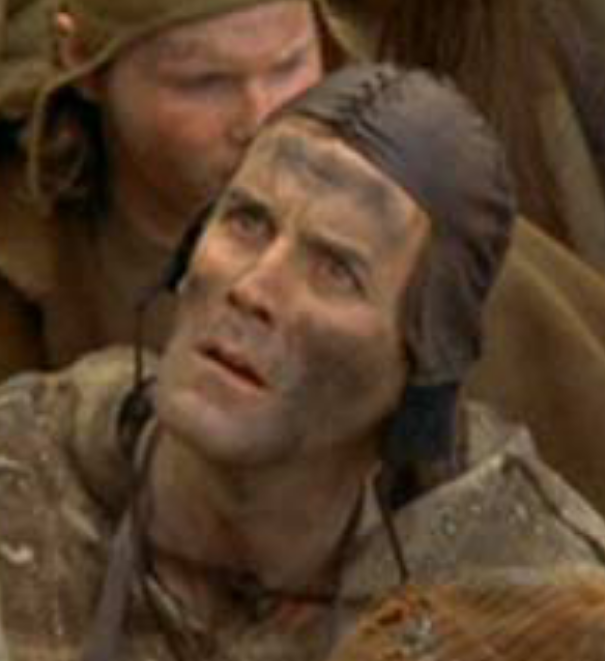

In [111]:
#im = Image.open(fnames[i]).convert('RGB')
#im = Image.open("D:\\imagenet2012\junco.jpg").convert('RGB')
im = Image.open("D:\\imagenet2012\john_cleese.png").convert('RGB')
#im = Image.open(fnames[np.argsort((y_val == 26))[-3]]).convert('RGB')
im

using model type: z

Original image predictions:
gyromitra (993): 0.12951360642910004
hartebeest (351): 0.10302609950304031
bloodhound, sleuthhound (163): 0.07946956157684326
Arabian camel, dromedary, Camelus dromedarius (354): 0.07580377906560898
potter's wheel (739): 0.035216543823480606

Generating adversarial example
L2: 38.697323

Adversarial image predictions:
bloodhound, sleuthhound (163): 0.20705418288707733
vizsla, Hungarian pointer (211): 0.16799017786979675
baboon (372): 0.14948055148124695
Sussex spaniel (220): 0.03418315201997757
Indian elephant, Elephas maximus (385): 0.031151315197348595


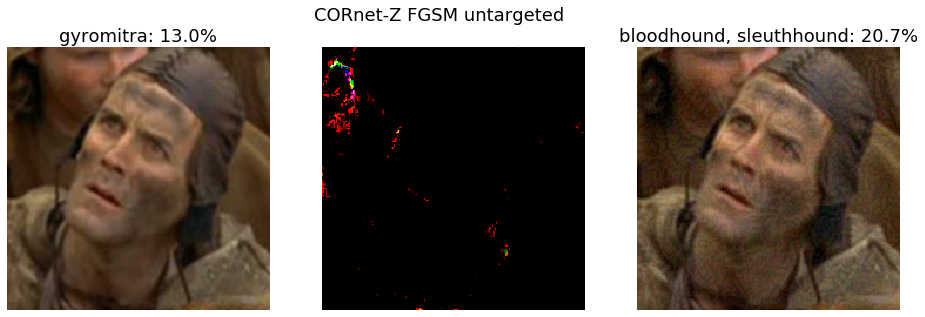

In [95]:
perform_attack(im, 'z')

using model type: s

Original image predictions:
tobacco shop, tobacconist shop, tobacconist (860): 0.06681566685438156
military uniform (652): 0.06391838937997818
plastic bag (728): 0.03656125068664551
panpipe, pandean pipe, syrinx (699): 0.03420693054795265
academic gown, academic robe, judge's robe (400): 0.03127473220229149

Generating adversarial example
L2: 38.68324

Adversarial image predictions:
Chesapeake Bay retriever (209): 0.40689268708229065
vizsla, Hungarian pointer (211): 0.042698100209236145
clumber, clumber spaniel (216): 0.025501064956188202
Sussex spaniel (220): 0.023614777252078056
curly-coated retriever (206): 0.022585485130548477


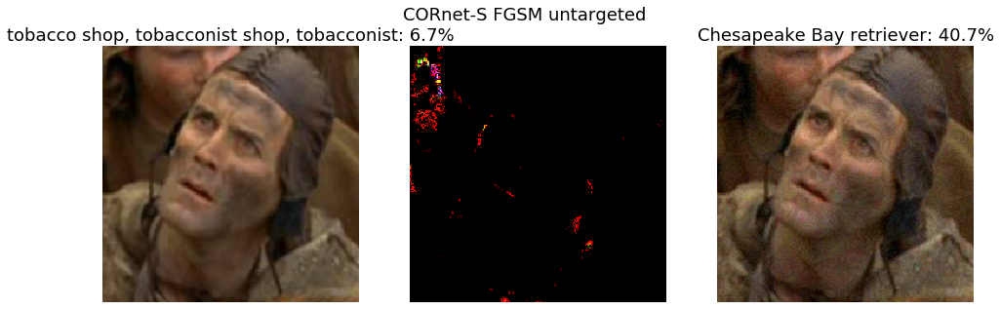

In [112]:
perform_attack(im, 's')

using model type: z

Original image predictions:
gyromitra (993): 0.12951360642910004
hartebeest (351): 0.10302609950304031
bloodhound, sleuthhound (163): 0.07946956157684326
Arabian camel, dromedary, Camelus dromedarius (354): 0.07580377906560898
potter's wheel (739): 0.035216543823480606

Generating adversarial example
L2: 115.23564

Adversarial image predictions:
sock (806): 0.05842985212802887
stole (824): 0.05400364473462105
cardigan (474): 0.047865573316812515
poncho (735): 0.030913857743144035
wool, woolen, woollen (911): 0.02191479131579399


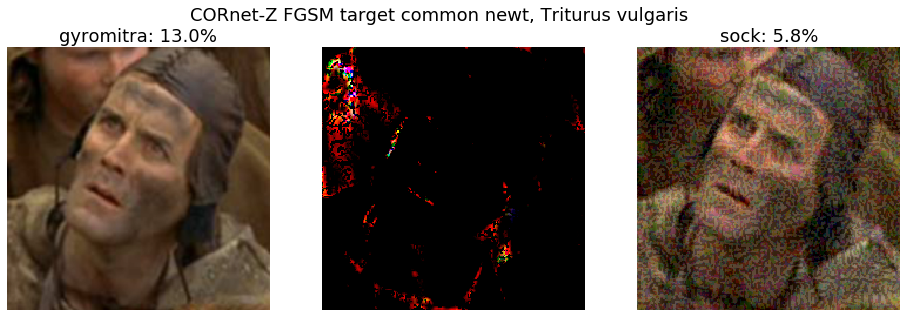

In [96]:
target_class=26 #lets turn him into a newt
perform_attack(im, 'z', target_class, True)

using model type: s

Original image predictions:
tobacco shop, tobacconist shop, tobacconist (860): 0.06681566685438156
military uniform (652): 0.06391838937997818
plastic bag (728): 0.03656125068664551
panpipe, pandean pipe, syrinx (699): 0.03420693054795265
academic gown, academic robe, judge's robe (400): 0.03127473220229149

Generating adversarial example
L2: 115.26699

Adversarial image predictions:
fur coat (568): 0.06077269837260246
Chesapeake Bay retriever (209): 0.052730366587638855
Sussex spaniel (220): 0.03642342612147331
stole (824): 0.035890791565179825
Irish setter, red setter (213): 0.028106318786740303


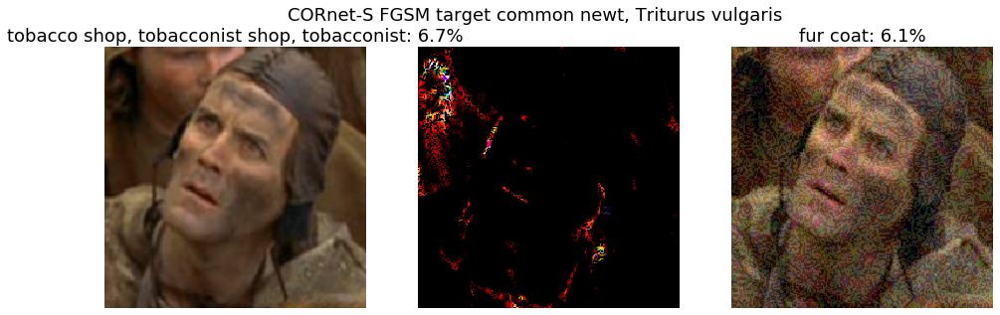

In [97]:
perform_attack(im, 's', target_class, True)

using model type: z

Original image predictions:
junco, snowbird (13): 0.8208329081535339
hornbill (93): 0.09115017205476761
bulbul (16): 0.07561135292053223
magpie (18): 0.002464961027726531
chickadee (19): 0.0017612366937100887

Generating adversarial example
L2: 38.797894

Adversarial image predictions:
hornbill (93): 0.9995673298835754
bulbul (16): 8.292552956845611e-05
toucan (96): 4.592572440742515e-05
hip, rose hip, rosehip (989): 2.6659228751668707e-05
chain (488): 1.762309329933487e-05


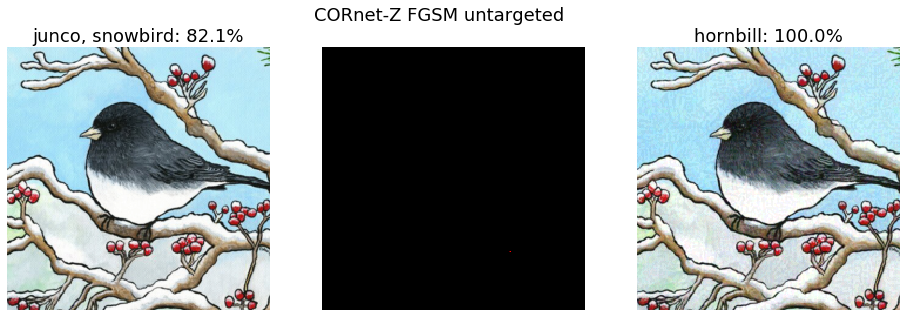

In [98]:
im = Image.open("D:\\imagenet2012\junco.jpg").convert('RGB')
perform_attack(im, 'z')

using model type: z

Original image predictions:
magpie (18): 0.9807124137878418
junco, snowbird (13): 0.008485633879899979
American coot, marsh hen, mud hen, water hen, Fulica americana (137): 0.006327349226921797
drake (97): 0.002436782931908965
coucal (91): 0.0003534578427206725

Generating adversarial example
L2: 38.79706

Adversarial image predictions:
junco, snowbird (13): 0.621090292930603
American coot, marsh hen, mud hen, water hen, Fulica americana (137): 0.36349278688430786
European gallinule, Porphyrio porphyrio (136): 0.004757111892104149
ruffed grouse, partridge, Bonasa umbellus (82): 0.002581158420071006
drake (97): 0.002308604307472706


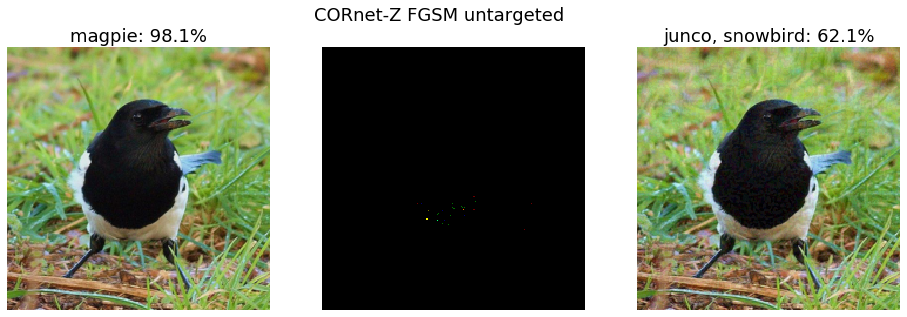

In [99]:
im = Image.open(fnames[39218]).convert('RGB')
perform_attack(im, 'z')

using model type: s

Original image predictions:
magpie (18): 0.9966254234313965
junco, snowbird (13): 0.0008507066522724926
water ouzel, dipper (20): 0.0008040928514674306
oystercatcher, oyster catcher (143): 0.0006524721975438297
chickadee (19): 0.0001927302946569398

Generating adversarial example
L2: 38.797188

Adversarial image predictions:
junco, snowbird (13): 0.26699161529541016
water ouzel, dipper (20): 0.07832138985395432
partridge (86): 0.04489007964730263
coucal (91): 0.04086801037192345
hen (8): 0.034521229565143585


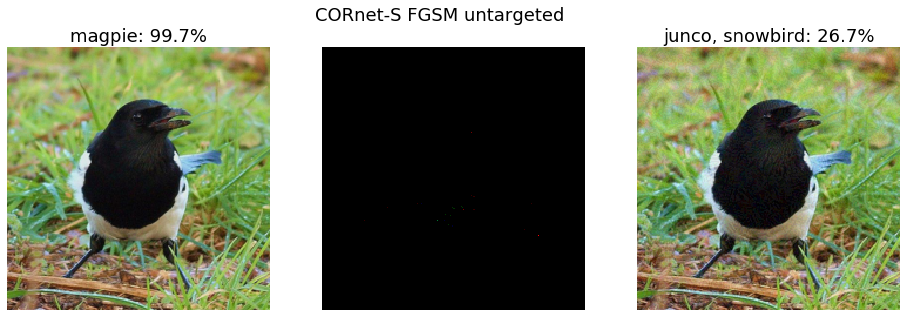

In [110]:
im = Image.open(fnames[39218]).convert('RGB')
perform_attack(im, 's')

using model type: s

Original image predictions:
magpie (18): 0.9966254234313965
junco, snowbird (13): 0.0008507066522724926
water ouzel, dipper (20): 0.0008040928514674306
oystercatcher, oyster catcher (143): 0.0006524721975438297
chickadee (19): 0.0001927302946569398

Generating adversarial example
L2: 115.593

Adversarial image predictions:
magpie (18): 0.33234739303588867
drake (97): 0.1766255795955658
peacock (84): 0.08984918892383575
hen (8): 0.03219444677233696
coucal (91): 0.03023553639650345


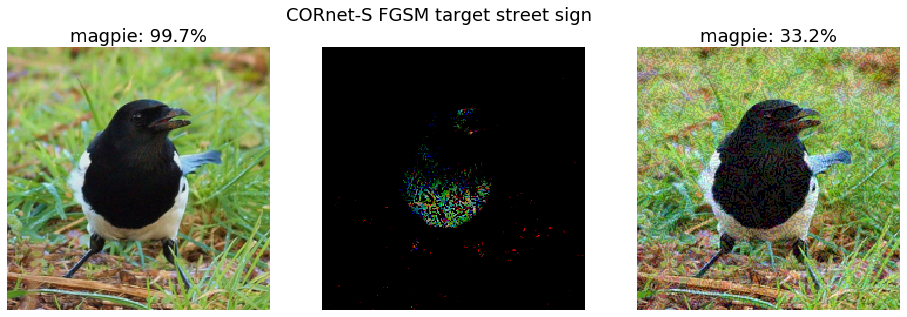

In [113]:
im = Image.open(fnames[39218]).convert('RGB')

target_class = 919 #street sign
perform_attack(im, 's', target_class, True)

using model type: s

Original image predictions:
magpie (18): 0.9966254234313965
junco, snowbird (13): 0.0008507066522724926
water ouzel, dipper (20): 0.0008040928514674306
oystercatcher, oyster catcher (143): 0.0006524721975438297
chickadee (19): 0.0001927302946569398

Generating adversarial example
L2: 38.797104

Adversarial image predictions:
jay (17): 0.3131965696811676
peacock (84): 0.14909113943576813
coucal (91): 0.12251254171133041
indigo bunting, indigo finch, indigo bird, Passerina cyanea (14): 0.0764700323343277
magpie (18): 0.0570262148976326


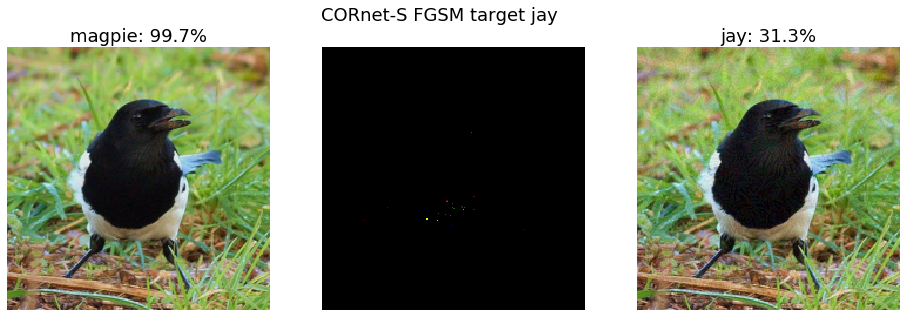

In [115]:
target_class = 17 #macaw
perform_attack(im, 's', target_class, True)

using model type: z

Original image predictions:
junco, snowbird (13): 0.8208329081535339
hornbill (93): 0.09115017205476761
bulbul (16): 0.07561135292053223
magpie (18): 0.002464961027726531
chickadee (19): 0.0017612366937100887

Generating adversarial example
L2: 38.79799

Adversarial image predictions:
great grey owl, great gray owl, Strix nebulosa (24): 0.418557733297348
tile roof (858): 0.14757594466209412
hornbill (93): 0.10238072276115417
bald eagle, American eagle, Haliaeetus leucocephalus (22): 0.059167925268411636
chainlink fence (489): 0.03861916437745094


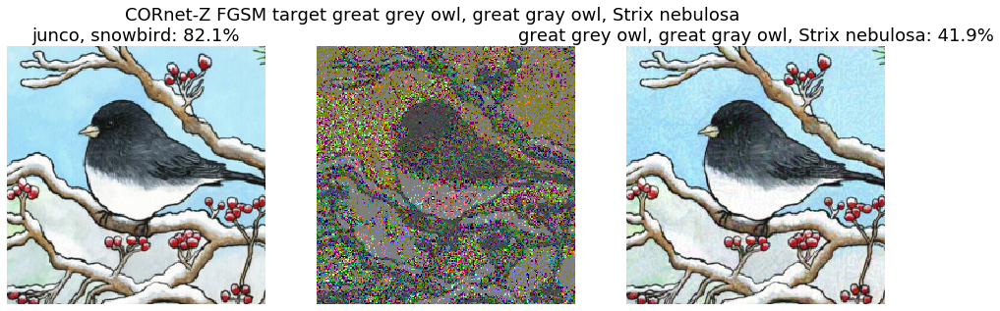

In [103]:
target_class = 24 #owl
im = Image.open("D:\\imagenet2012\junco.jpg").convert('RGB')
perform_attack(im, 'z', target_class, True)

using model type: s

Original image predictions:
junco, snowbird (13): 0.8199988603591919
prayer rug, prayer mat (741): 0.014861010946333408
handkerchief, hankie, hanky, hankey (591): 0.012516302056610584
robin, American robin, Turdus migratorius (15): 0.009601126424968243
tray (868): 0.008169511333107948

Generating adversarial example
L2: 38.797894

Adversarial image predictions:
handkerchief, hankie, hanky, hankey (591): 0.2238214910030365
tray (868): 0.1530425101518631
prayer rug, prayer mat (741): 0.0818370133638382
jigsaw puzzle (611): 0.049866750836372375
pillow (721): 0.046641755849123


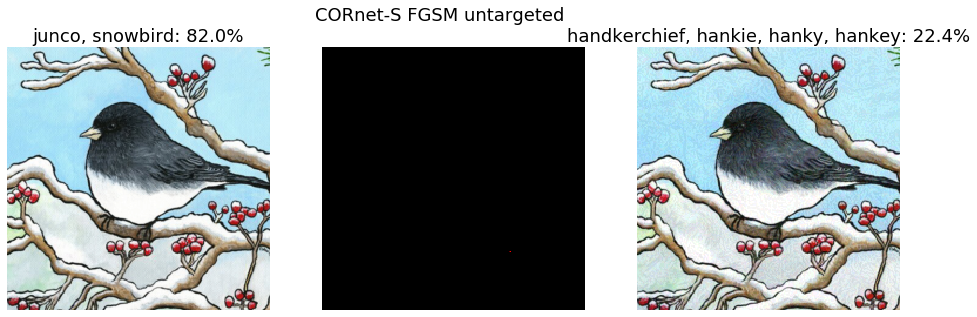

In [104]:

perform_attack(im, 's')

using model type: s

Original image predictions:
junco, snowbird (13): 0.8199988603591919
prayer rug, prayer mat (741): 0.014861010946333408
handkerchief, hankie, hanky, hankey (591): 0.012516302056610584
robin, American robin, Turdus migratorius (15): 0.009601126424968243
tray (868): 0.008169511333107948

Generating adversarial example
L2: 116.380554

Adversarial image predictions:
jigsaw puzzle (611): 0.26384690403938293
bib (443): 0.06925574690103531
tray (868): 0.0581631064414978
mask (643): 0.0393650159239769
handkerchief, hankie, hanky, hankey (591): 0.035089004784822464


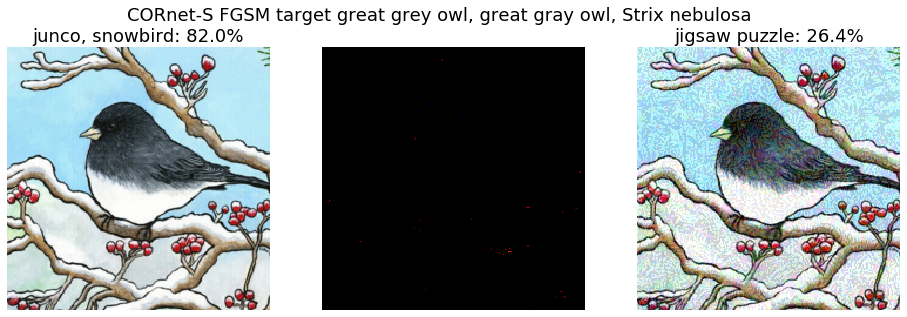

In [105]:
perform_attack(im, 's', target_class, True)

using model type: z

Original image predictions:
sandal (774): 0.1541583389043808
running shoe (770): 0.10500852018594742
clog, geta, patten, sabot (502): 0.05704495310783386
buckle (464): 0.056612420827150345
hatchet (596): 0.036182377487421036

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
macaw (88): 0.7217124700546265
peacock (84): 0.1309233158826828
jay (17): 0.060147725045681
magpie (18): 0.02214239351451397
indigo bunting, indigo finch, indigo bird, Passerina cyanea (14): 0.015377718023955822


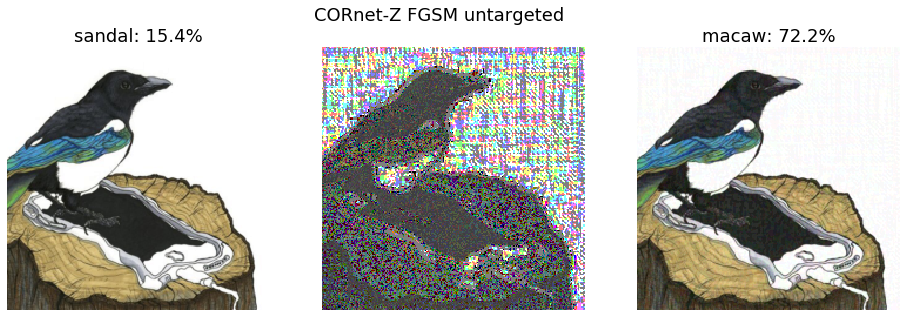

In [106]:
im = Image.open("D:\\imagenet2012\\magpie.jpg").convert('RGB')
perform_attack(im, 'z')

using model type: s

Original image predictions:
magpie (18): 0.807257354259491
jay (17): 0.09320010989904404
black grouse (80): 0.010717383585870266
stole (824): 0.005895387381315231
water ouzel, dipper (20): 0.0035025232937186956

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
stole (824): 0.12101331353187561
wool, woolen, woollen (911): 0.07333642989397049
handkerchief, hankie, hanky, hankey (591): 0.017750801518559456
hamper (588): 0.01620127074420452
terrapin (36): 0.015551247633993626


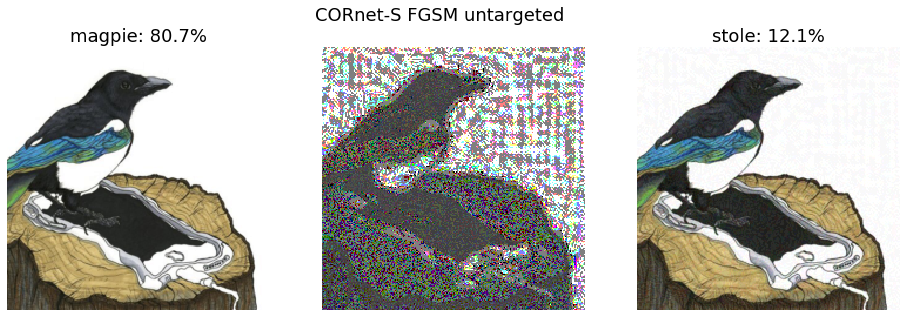

In [107]:
perform_attack(im, 's')

using model type: z

Original image predictions:
sandal (774): 0.1541583389043808
running shoe (770): 0.10500852018594742
clog, geta, patten, sabot (502): 0.05704495310783386
buckle (464): 0.056612420827150345
hatchet (596): 0.036182377487421036

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
junco, snowbird (13): 0.5581821799278259
chickadee (19): 0.3176861107349396
magpie (18): 0.10067674517631531
jay (17): 0.013097774237394333
brambling, Fringilla montifringilla (10): 0.0026712079998105764


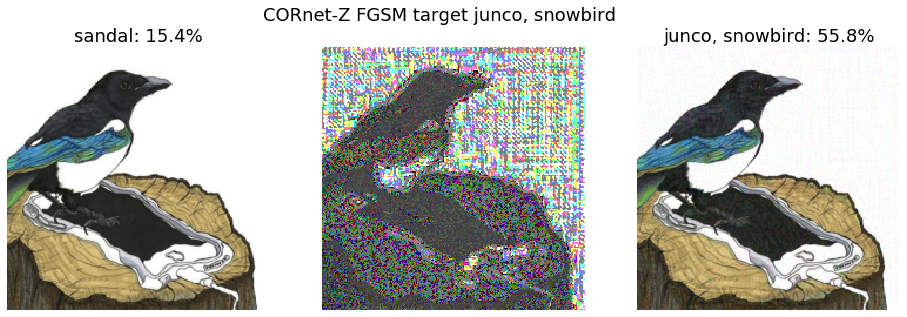

In [108]:
perform_attack(im, 'z', 13, True)

using model type: s

Original image predictions:
magpie (18): 0.807257354259491
jay (17): 0.09320010989904404
black grouse (80): 0.010717383585870266
stole (824): 0.005895387381315231
water ouzel, dipper (20): 0.0035025232937186956

Generating adversarial example
L2: 116.392654

Adversarial image predictions:
stole (824): 0.08240339159965515
necklace (679): 0.038729965686798096
purse (748): 0.024238811805844307
terrapin (36): 0.017345484346151352
mailbag, postbag (636): 0.017245350405573845


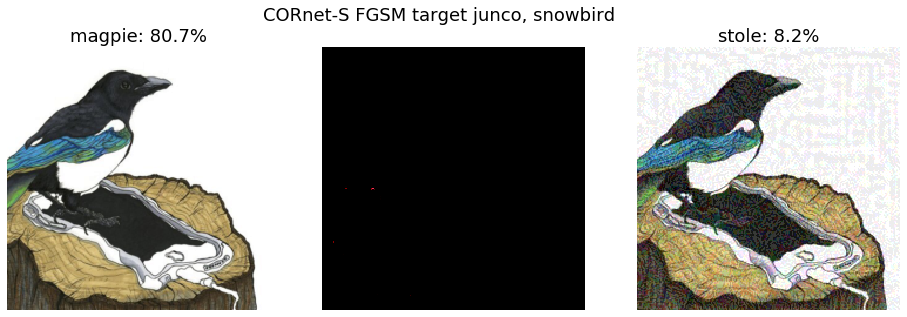

In [109]:
perform_attack(im, 's', 13, True)

using model type: z

Original image predictions:
sandal (774): 0.1541583389043808
running shoe (770): 0.10500852018594742
clog, geta, patten, sabot (502): 0.05704495310783386
buckle (464): 0.056612420827150345
hatchet (596): 0.036182377487421036

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
junco, snowbird (13): 0.5581821799278259
chickadee (19): 0.3176861107349396
magpie (18): 0.10067674517631531
jay (17): 0.013097774237394333
brambling, Fringilla montifringilla (10): 0.0026712079998105764


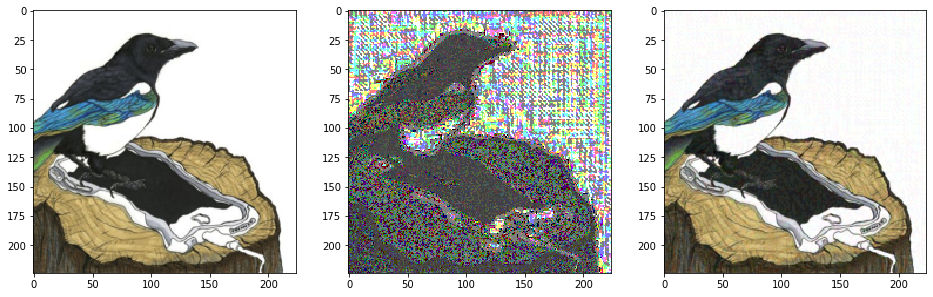

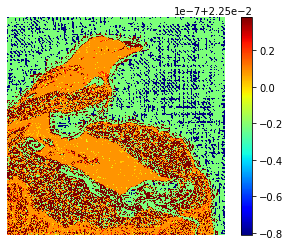

In [26]:
perform_attack(im, 'z', 13, True)

wire-haired fox terrier
using model type: z

Original image predictions:
Lakeland terrier (189): 0.1605711579322815
Airedale, Airedale terrier (191): 0.12620742619037628
hamster (333): 0.05710998922586441
teddy, teddy bear (850): 0.04172852262854576
toy poodle (265): 0.0393180325627327

Generating adversarial example
L2: 38.391247

Adversarial image predictions:
green mamba (64): 0.3530643582344055
fountain (562): 0.16389933228492737
ear, spike, capitulum (998): 0.11124982684850693
green snake, grass snake (55): 0.03333362936973572
green lizard, Lacerta viridis (46): 0.02893778681755066


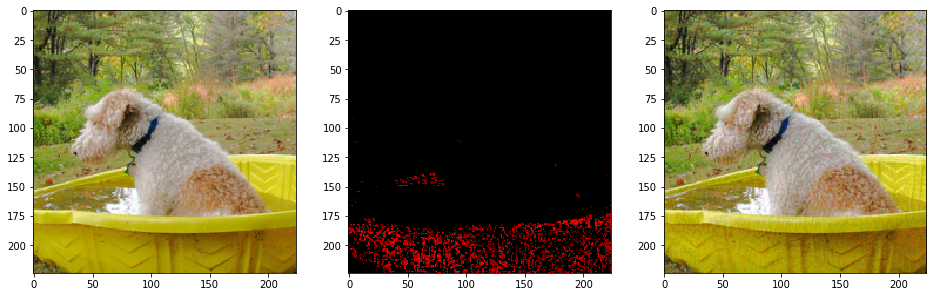

using model type: s

Original image predictions:
Lakeland terrier (189): 0.44783318042755127
wire-haired fox terrier (188): 0.29494354128837585
Bedlington terrier (181): 0.08079919219017029
soft-coated wheaten terrier (202): 0.0720813199877739
Sealyham terrier, Sealyham (190): 0.02853361703455448

Generating adversarial example
L2: 38.396328

Adversarial image predictions:
hoopskirt, crinoline (601): 0.24932020902633667
vestment (887): 0.14319917559623718
groom, bridegroom (982): 0.12040745466947556
gown (578): 0.09337522834539413
ram, tup (348): 0.0822247639298439


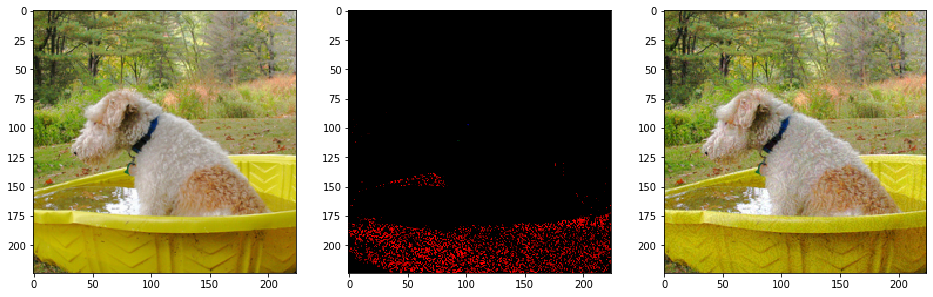

vault
using model type: z

Original image predictions:
vault (884): 0.7564801573753357
greenhouse, nursery, glasshouse (580): 0.032889969646930695
dome (538): 0.02754790335893631
quilt, comforter, comfort, puff (750): 0.02114807441830635
dam, dike, dyke (525): 0.020136743783950806

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
jigsaw puzzle (611): 0.05534633621573448
quilt, comforter, comfort, puff (750): 0.03610000014305115
sock (806): 0.036031536757946014
broom (462): 0.031937126070261
greenhouse, nursery, glasshouse (580): 0.02797025442123413


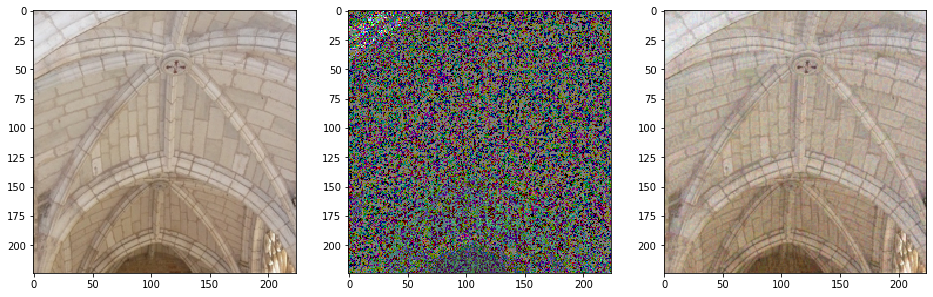

using model type: s

Original image predictions:
vault (884): 0.9964762926101685
monastery (663): 0.0009347196901217103
dome (538): 0.000893225718755275
church, church building (497): 0.0007679304108023643
triumphal arch (873): 0.0003045729536097497

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
vault (884): 0.44006073474884033
church, church building (497): 0.10213527083396912
maze, labyrinth (646): 0.05153857171535492
monastery (663): 0.04446028545498848
altar (406): 0.03638634830713272


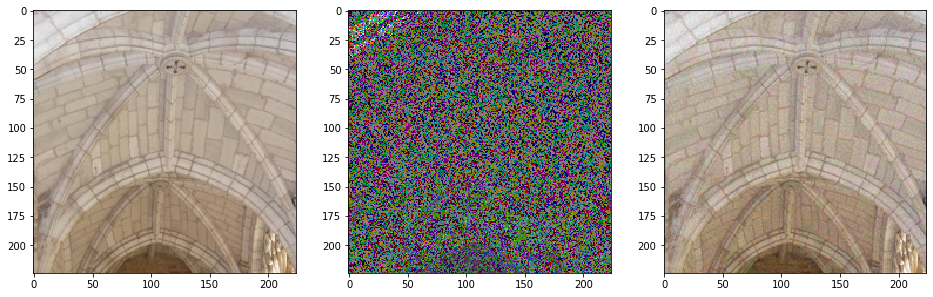

fox squirrel, eastern fox squirrel, Sciurus niger
using model type: z

Original image predictions:
fox squirrel, eastern fox squirrel, Sciurus niger (335): 0.5741459727287292
grey fox, gray fox, Urocyon cinereoargenteus (280): 0.1274099200963974
hare (331): 0.060563843697309494
coyote, prairie wolf, brush wolf, Canis latrans (272): 0.041614484041929245
kit fox, Vulpes macrotis (278): 0.03573917970061302

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
kit fox, Vulpes macrotis (278): 0.25652244687080383
coyote, prairie wolf, brush wolf, Canis latrans (272): 0.19689089059829712
dhole, Cuon alpinus (274): 0.1661013513803482
red fox, Vulpes vulpes (277): 0.15938445925712585
grey fox, gray fox, Urocyon cinereoargenteus (280): 0.08508549630641937


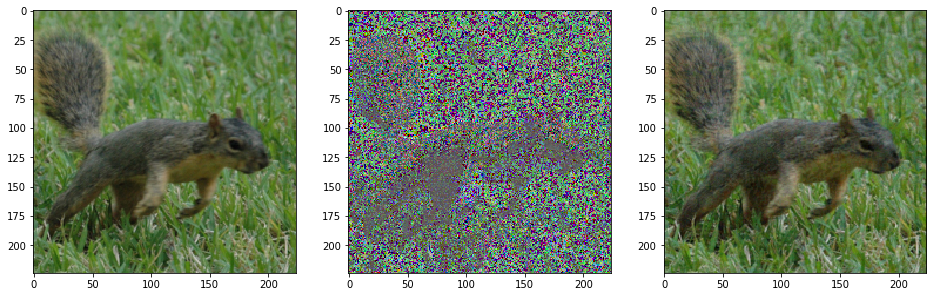

using model type: s

Original image predictions:
fox squirrel, eastern fox squirrel, Sciurus niger (335): 0.9994586110115051
hare (331): 0.00022437218285631388
wood rabbit, cottontail, cottontail rabbit (330): 9.921791206579655e-05
marmot (336): 8.6446940258611e-05
mousetrap (674): 3.300204480183311e-05

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
hare (331): 0.3982066214084625
beaver (337): 0.11599702388048172
wood rabbit, cottontail, cottontail rabbit (330): 0.03241853415966034
wild boar, boar, Sus scrofa (342): 0.028973989188671112
otter (360): 0.024282561615109444


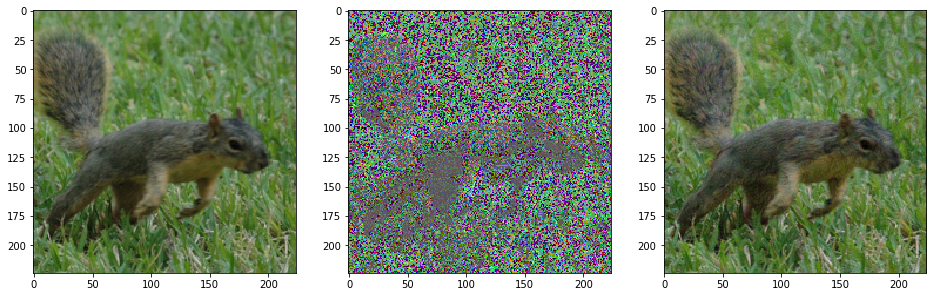

ski
using model type: z

Original image predictions:
snowmobile (802): 0.2860759496688843
alp (970): 0.1485639363527298
dogsled, dog sled, dog sleigh (537): 0.10122014582157135
ski (795): 0.07517732679843903
warplane, military plane (895): 0.02461637184023857

Generating adversarial example
L2: 38.65495

Adversarial image predictions:
lakeside, lakeshore (975): 0.11064347624778748
alp (970): 0.10752894729375839
tile roof (858): 0.09426654130220413
seashore, coast, seacoast, sea-coast (978): 0.08878955245018005
maze, labyrinth (646): 0.0723261758685112


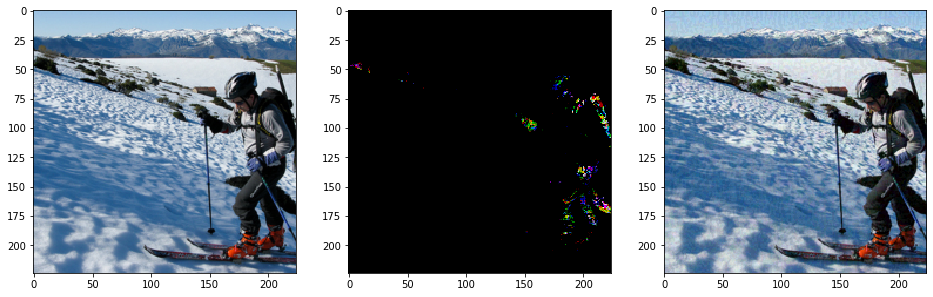

using model type: s

Original image predictions:
ski (795): 0.9969921708106995
alp (970): 0.001692228834144771
dogsled, dog sled, dog sleigh (537): 0.0008854513871483505
snowmobile (802): 0.0002873338235076517
bobsled, bobsleigh, bob (450): 1.9008482922799885e-05

Generating adversarial example
L2: 38.634285

Adversarial image predictions:
chain (488): 0.10901514440774918
alp (970): 0.09230297803878784
padlock (695): 0.0707935243844986
dogsled, dog sled, dog sleigh (537): 0.05253705382347107
lakeside, lakeshore (975): 0.03681251406669617


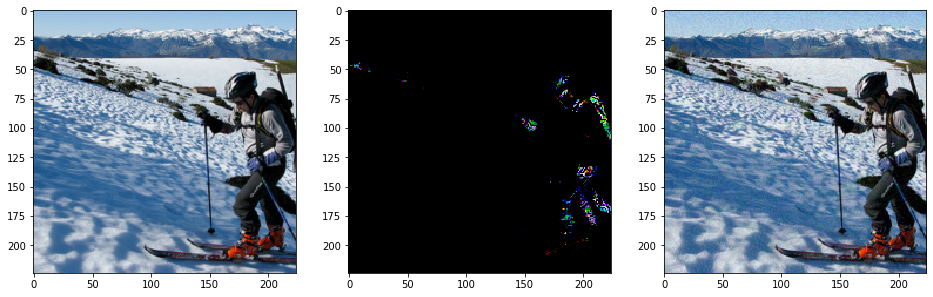

EntleBucher
using model type: z

Original image predictions:
Appenzeller (240): 0.23776128888130188
EntleBucher (241): 0.13980385661125183
Greater Swiss Mountain dog (238): 0.12717017531394958
bluetick (164): 0.07036546617746353
Doberman, Doberman pinscher (236): 0.04918292164802551

Generating adversarial example
L2: 36.80472

Adversarial image predictions:
artichoke, globe artichoke (944): 0.1902516484260559
banana (954): 0.1435912698507309
custard apple (956): 0.11479568481445312
African chameleon, Chamaeleo chamaeleon (47): 0.06941355019807816
green snake, grass snake (55): 0.06859943270683289


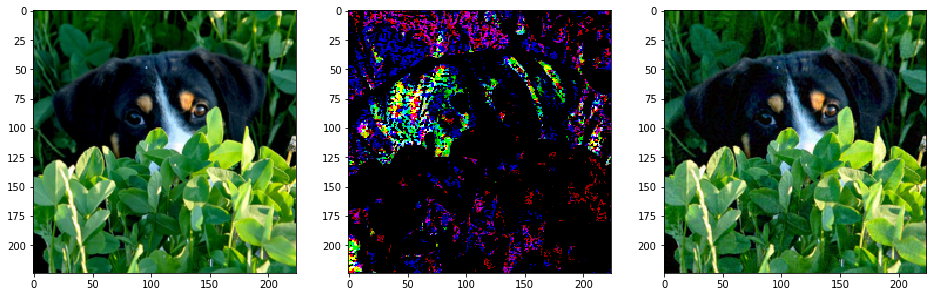

using model type: s

Original image predictions:
bluetick (164): 0.5661404132843018
EntleBucher (241): 0.3555718958377838
Greater Swiss Mountain dog (238): 0.03348461911082268
Appenzeller (240): 0.021341396495699883
Walker hound, Walker foxhound (166): 0.00538340350612998

Generating adversarial example
L2: 36.731163

Adversarial image predictions:
Bernese mountain dog (239): 0.4822675883769989
EntleBucher (241): 0.24288544058799744
Greater Swiss Mountain dog (238): 0.13628549873828888
Appenzeller (240): 0.1337638795375824
sloth bear, Melursus ursinus, Ursus ursinus (297): 0.0017924660351127386


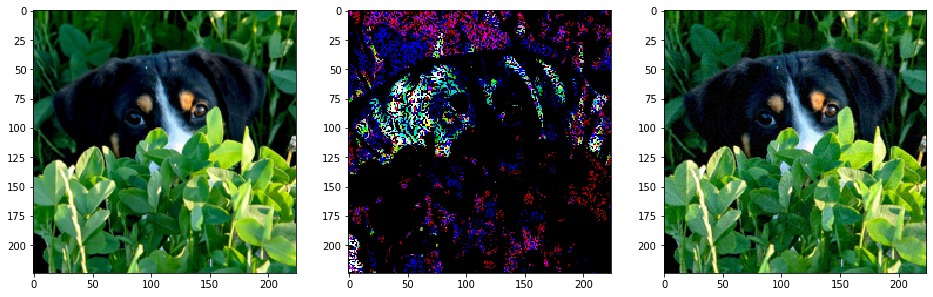

swimming trunks, bathing trunks
using model type: z

Original image predictions:
swimming trunks, bathing trunks (842): 0.8484452366828918
maillot (638): 0.03791904076933861
bathing cap, swimming cap (433): 0.034893665462732315
sarong (775): 0.020255200564861298
bikini, two-piece (445): 0.01903698407113552

Generating adversarial example
L2: 38.79144

Adversarial image predictions:
maillot (638): 0.3387576639652252
maillot, tank suit (639): 0.14119824767112732
sarong (775): 0.08778911083936691
bikini, two-piece (445): 0.0357835590839386
miniskirt, mini (655): 0.01998935081064701


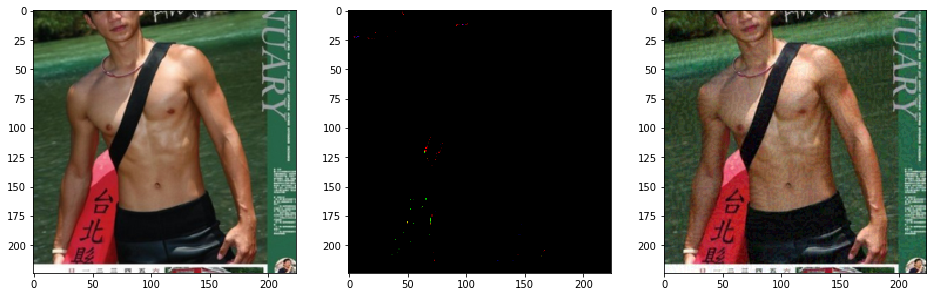

using model type: s

Original image predictions:
swimming trunks, bathing trunks (842): 0.5373095870018005
bikini, two-piece (445): 0.12612898647785187
bathing cap, swimming cap (433): 0.124347984790802
maillot (638): 0.06227591261267662
maillot, tank suit (639): 0.036837976425886154

Generating adversarial example
L2: 38.790737

Adversarial image predictions:
maillot (638): 0.30902960896492004
maillot, tank suit (639): 0.2129031866788864
bikini, two-piece (445): 0.2006482481956482
bathing cap, swimming cap (433): 0.06447111815214157
paddle, boat paddle (693): 0.03350266069173813


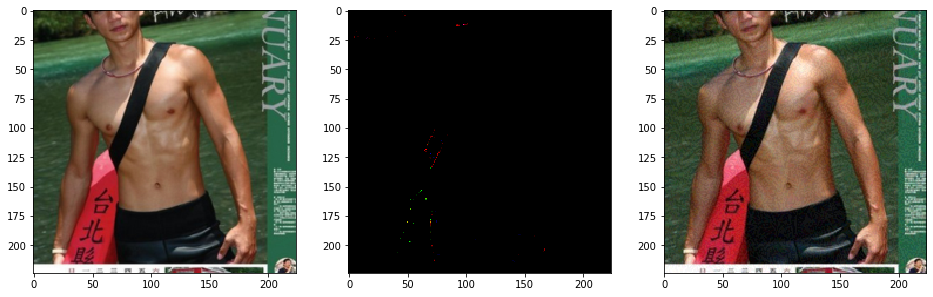

scorpion
using model type: z

Original image predictions:
scorpion (71): 0.27706918120384216
cricket (312): 0.19074422121047974
padlock (695): 0.08898322284221649
cicada, cicala (316): 0.07539897412061691
grasshopper, hopper (311): 0.06667274981737137

Generating adversarial example
L2: 38.665665

Adversarial image predictions:
padlock (695): 0.2680491507053375
vestment (887): 0.17751958966255188
grasshopper, hopper (311): 0.17043374478816986
cricket (312): 0.04525141417980194
birdhouse (448): 0.04047245532274246


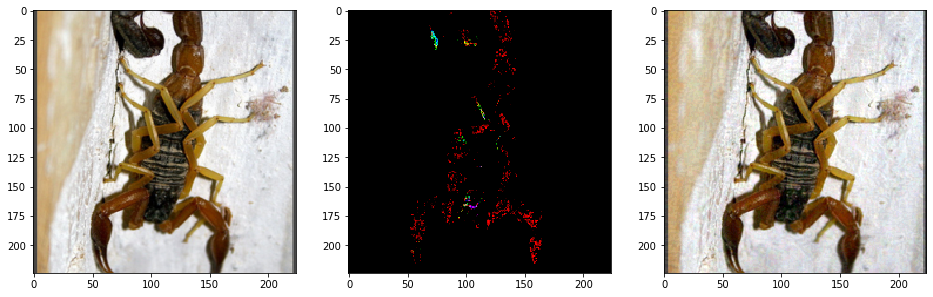

using model type: s

Original image predictions:
scorpion (71): 0.9994584321975708
cricket (312): 0.00043724378338083625
cicada, cicala (316): 4.916506804875098e-05
grasshopper, hopper (311): 2.3859282009652816e-05
centipede (79): 6.762347311450867e-06

Generating adversarial example
L2: 38.66765

Adversarial image predictions:
cricket (312): 0.41778433322906494
grasshopper, hopper (311): 0.11271380633115768
cicada, cicala (316): 0.07252930849790573
cockroach, roach (314): 0.049345966428518295
honeycomb (599): 0.030461212620139122


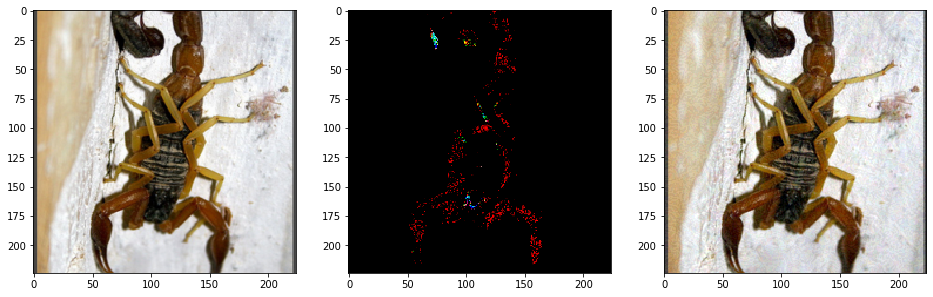

torch
using model type: z

Original image predictions:
torch (862): 0.30248770117759705
theater curtain, theatre curtain (854): 0.2447170615196228
candle, taper, wax light (470): 0.1569538414478302
stage (819): 0.1410362869501114
cinema, movie theater, movie theatre, movie house, picture palace (498): 0.03990022465586662

Generating adversarial example
L2: 37.77288

Adversarial image predictions:
theater curtain, theatre curtain (854): 0.9296570420265198
stage (819): 0.019818991422653198
candle, taper, wax light (470): 0.010357600636780262
restaurant, eating house, eating place, eatery (762): 0.0080338716506958
confectionery, confectionary, candy store (509): 0.004433848895132542


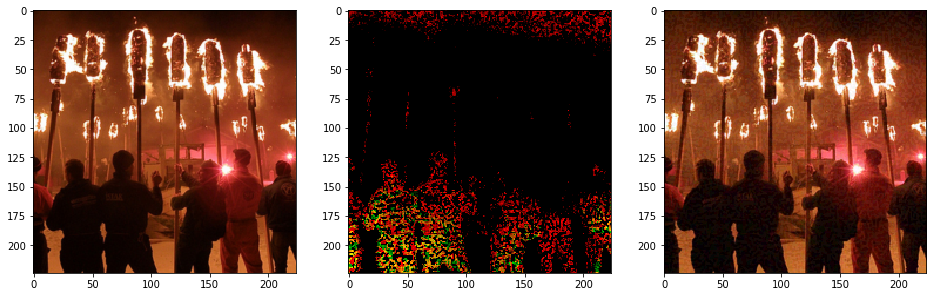

using model type: s

Original image predictions:
torch (862): 0.9766042828559875
spotlight, spot (818): 0.008991693146526814
candle, taper, wax light (470): 0.004910426214337349
carousel, carrousel, merry-go-round, roundabout, whirligig (476): 0.0023906028363853693
stage (819): 0.0013714978704228997

Generating adversarial example
L2: 37.75928

Adversarial image predictions:
fountain (562): 0.4257170259952545
stage (819): 0.104487344622612
spotlight, spot (818): 0.06231244280934334
digital clock (530): 0.05328069627285004
carousel, carrousel, merry-go-round, roundabout, whirligig (476): 0.04239707812666893


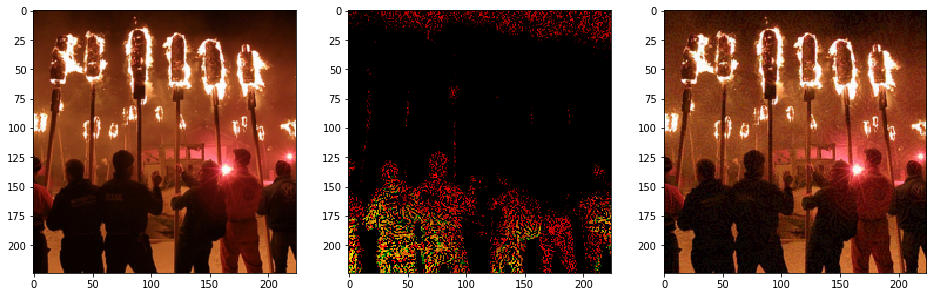

pug, pug-dog
using model type: z

Original image predictions:
pug, pug-dog (254): 0.8537684679031372
French bulldog (245): 0.03687810152769089
Italian greyhound (171): 0.021096399053931236
Staffordshire bullterrier, Staffordshire bull terrier (179): 0.019542301073670387
American Staffordshire terrier, Staffordshire terrier, American pit bull terrier, pit bull terrier (180): 0.01910475641489029

Generating adversarial example
L2: 38.797237

Adversarial image predictions:
American Staffordshire terrier, Staffordshire terrier, American pit bull terrier, pit bull terrier (180): 0.6678295731544495
Italian greyhound (171): 0.23578223586082458
Staffordshire bullterrier, Staffordshire bull terrier (179): 0.02879604510962963
German short-haired pointer (210): 0.015199766494333744
basenji (253): 0.014457869343459606


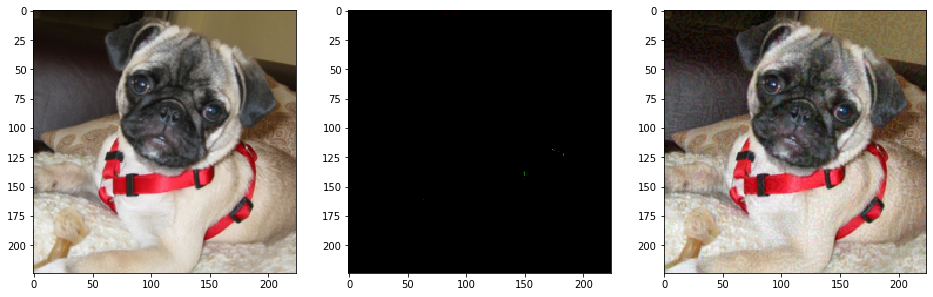

using model type: s

Original image predictions:
pug, pug-dog (254): 0.9804924726486206
bull mastiff (243): 0.007087726145982742
French bulldog (245): 0.0026901254896074533
tennis ball (852): 0.0013578616781160235
Brabancon griffon (262): 0.0011518935207277536

Generating adversarial example
L2: 38.797104

Adversarial image predictions:
Lakeland terrier (189): 0.18977709114551544
Border terrier (182): 0.10708808898925781
bluetick (164): 0.06980786472558975
Irish terrier (184): 0.06468695402145386
tennis ball (852): 0.04455912485718727


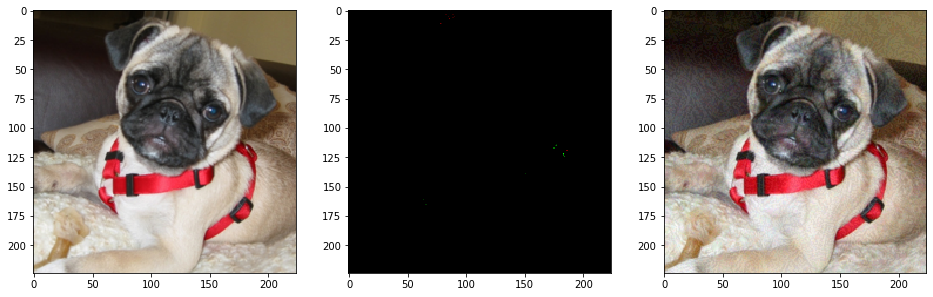

eft
using model type: z

Original image predictions:
eft (27): 0.30481448769569397
tick (78): 0.09887755662202835
axolotl, mud puppy, Ambystoma mexicanum (29): 0.08268961310386658
common newt, Triturus vulgaris (26): 0.07239274680614471
conch (112): 0.044455960392951965

Generating adversarial example
L2: 38.79806

Adversarial image predictions:
chambered nautilus, pearly nautilus, nautilus (117): 0.07386089861392975
spindle (816): 0.06847064197063446
ocarina, sweet potato (684): 0.059760212898254395
conch (112): 0.04863697662949562
tick (78): 0.035544298589229584


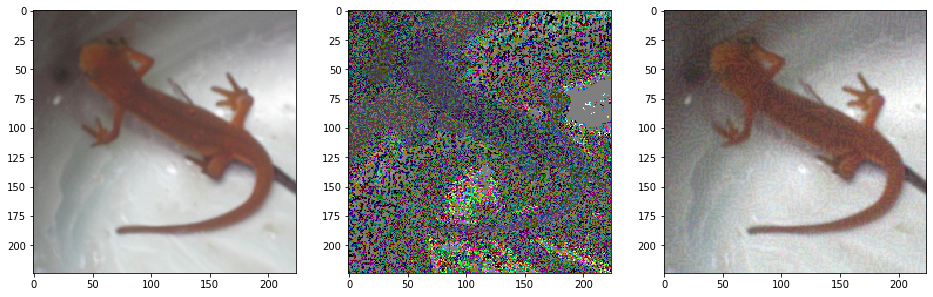

using model type: s

Original image predictions:
eft (27): 0.8630159497261047
common newt, Triturus vulgaris (26): 0.1300530880689621
axolotl, mud puppy, Ambystoma mexicanum (29): 0.004958889912813902
spotted salamander, Ambystoma maculatum (28): 0.0009303786791861057
banded gecko (38): 0.0005672697443515062

Generating adversarial example
L2: 38.79806

Adversarial image predictions:
axolotl, mud puppy, Ambystoma mexicanum (29): 0.7203866839408875
common newt, Triturus vulgaris (26): 0.22460833191871643
eft (27): 0.021178996190428734
scorpion (71): 0.015181570313870907
tarantula (76): 0.002905552741140127


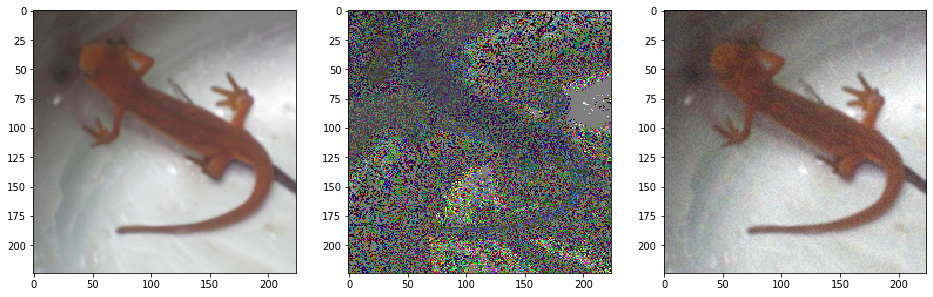

analog clock
using model type: z

Original image predictions:
barometer (426): 0.27262598276138306
face powder (551): 0.14538194239139557
magnetic compass (635): 0.12106800079345703
analog clock (409): 0.09613549709320068
puck, hockey puck (746): 0.08158283680677414

Generating adversarial example
L2: 38.46311

Adversarial image predictions:
face powder (551): 0.2827918231487274
lens cap, lens cover (622): 0.24341565370559692
Loafer (630): 0.09671313315629959
sandal (774): 0.058692995458841324
clog, geta, patten, sabot (502): 0.043700456619262695


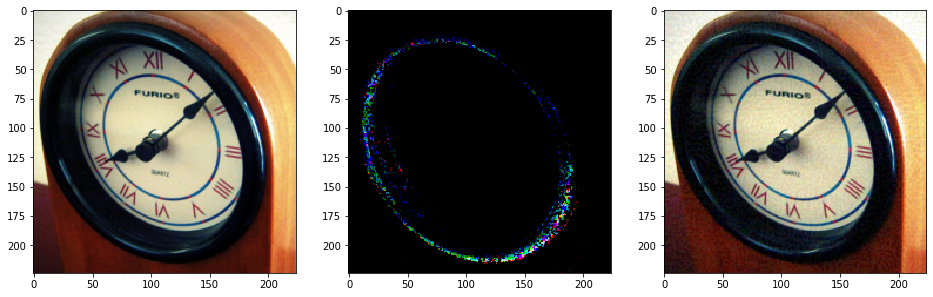

using model type: s

Original image predictions:
wall clock (892): 0.5984664559364319
analog clock (409): 0.2624368667602539
barometer (426): 0.13360647857189178
magnetic compass (635): 0.003619380760937929
stopwatch, stop watch (826): 0.0011013061739504337

Generating adversarial example
L2: 38.454407

Adversarial image predictions:
barometer (426): 0.981484055519104
magnetic compass (635): 0.009950119070708752
stopwatch, stop watch (826): 0.005185006186366081
analog clock (409): 0.0014147210167720914
scale, weighing machine (778): 0.0012550336541607976


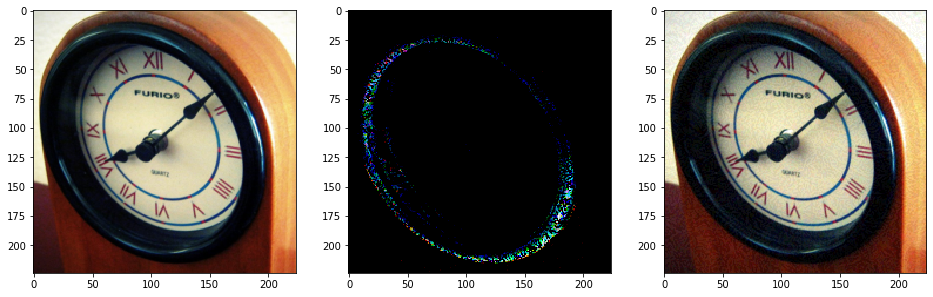

bicycle-built-for-two, tandem bicycle, tandem
using model type: z

Original image predictions:
tricycle, trike, velocipede (870): 0.33778950572013855
bicycle-built-for-two, tandem bicycle, tandem (444): 0.14734302461147308
unicycle, monocycle (880): 0.08821728825569153
moped (665): 0.047360245138406754
jinrikisha, ricksha, rickshaw (612): 0.03341224789619446

Generating adversarial example
L2: 38.773975

Adversarial image predictions:
standard poodle (267): 0.04266507178544998
briard (226): 0.04164354130625725
Bouvier des Flandres, Bouviers des Flandres (233): 0.038586147129535675
German shepherd, German shepherd dog, German police dog, alsatian (235): 0.036836929619312286
wool, woolen, woollen (911): 0.03559344261884689


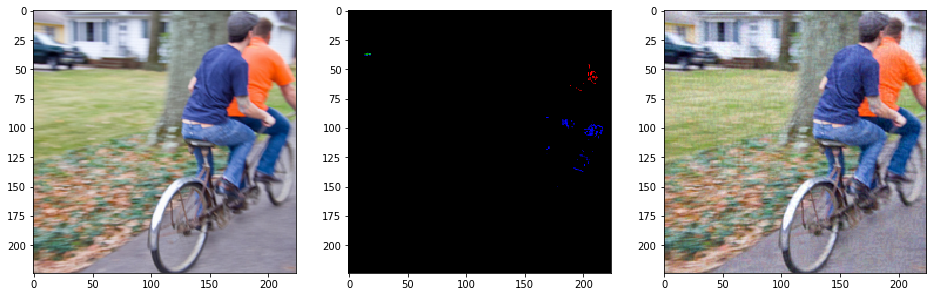

using model type: s

Original image predictions:
bicycle-built-for-two, tandem bicycle, tandem (444): 0.5697702765464783
tricycle, trike, velocipede (870): 0.2353622168302536
unicycle, monocycle (880): 0.13387368619441986
moped (665): 0.024454748257994652
mountain bike, all-terrain bike, off-roader (671): 0.023299414664506912

Generating adversarial example
L2: 38.77234

Adversarial image predictions:
tricycle, trike, velocipede (870): 0.8914014101028442
unicycle, monocycle (880): 0.03936668485403061
moped (665): 0.03208211064338684
motor scooter, scooter (670): 0.008263343945145607
barrow, garden cart, lawn cart, wheelbarrow (428): 0.002877426566556096


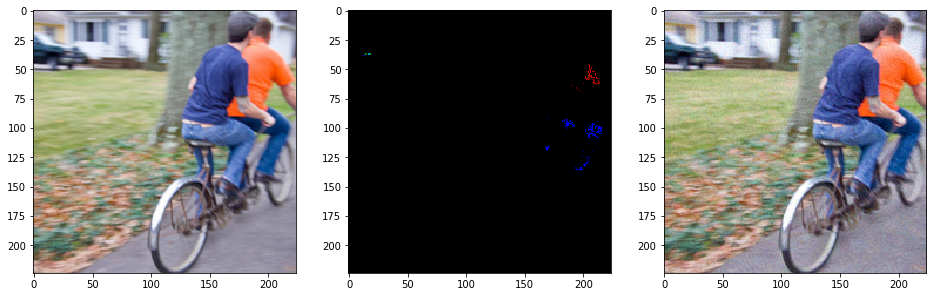

bathing cap, swimming cap
using model type: z

Original image predictions:
maillot, tank suit (639): 0.17885491251945496
sarong (775): 0.1771627515554428
bathing cap, swimming cap (433): 0.17472557723522186
swimming trunks, bathing trunks (842): 0.0641060471534729
maillot (638): 0.04794595018029213

Generating adversarial example
L2: 38.79723

Adversarial image predictions:
wool, woolen, woollen (911): 0.7206353545188904
cardigan (474): 0.06937440484762192
mitten (658): 0.0630747377872467
sock (806): 0.04598979279398918
teddy, teddy bear (850): 0.03469807282090187


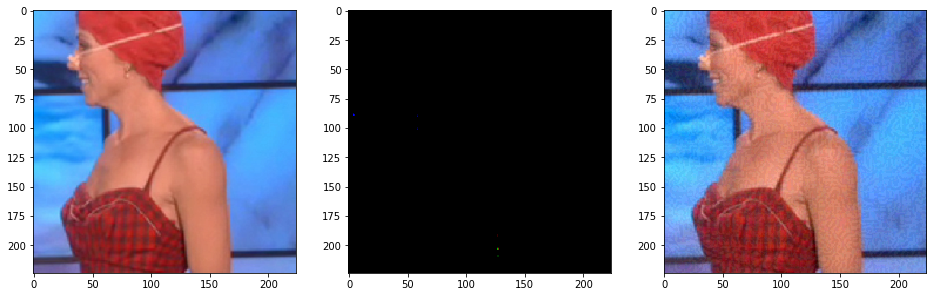

using model type: s

Original image predictions:
bathing cap, swimming cap (433): 0.3224984407424927
maillot, tank suit (639): 0.14327168464660645
swimming trunks, bathing trunks (842): 0.1152728721499443
sarong (775): 0.08909942209720612
maillot (638): 0.08683720231056213

Generating adversarial example
L2: 38.79718

Adversarial image predictions:
mitten (658): 0.30154258012771606
brassiere, bra, bandeau (459): 0.12710952758789062
maillot (638): 0.10051894187927246
maillot, tank suit (639): 0.08162099868059158
sarong (775): 0.0789107084274292


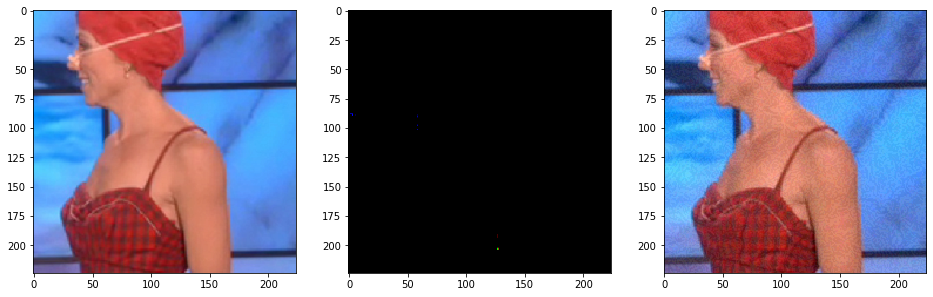

cabbage butterfly
using model type: z

Original image predictions:
cabbage butterfly (324): 0.9946897625923157
sulphur butterfly, sulfur butterfly (325): 0.00504347262904048
lycaenid, lycaenid butterfly (326): 0.00014499947428703308
ringlet, ringlet butterfly (322): 9.719248191686347e-05
custard apple (956): 1.3058592230663635e-05

Generating adversarial example
L2: 38.684093

Adversarial image predictions:
sulphur butterfly, sulfur butterfly (325): 0.9545459747314453
jackfruit, jak, jack (955): 0.032222259789705276
custard apple (956): 0.007877262309193611
African chameleon, Chamaeleo chamaeleon (47): 0.0010724794119596481
cabbage butterfly (324): 0.0007530027651228011


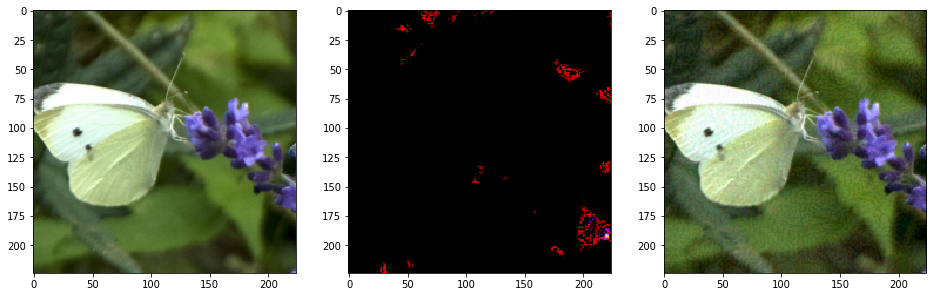

using model type: s

Original image predictions:
cabbage butterfly (324): 0.9996952414512634
sulphur butterfly, sulfur butterfly (325): 0.00029080096282996237
ringlet, ringlet butterfly (322): 8.315040759043768e-06
lycaenid, lycaenid butterfly (326): 4.823964900424471e-06
admiral (321): 6.584878065041266e-07

Generating adversarial example
L2: 38.684273

Adversarial image predictions:
cabbage butterfly (324): 0.539039134979248
sulphur butterfly, sulfur butterfly (325): 0.1700664758682251
ringlet, ringlet butterfly (322): 0.05033562332391739
admiral (321): 0.021203085780143738
bee (309): 0.01796163246035576


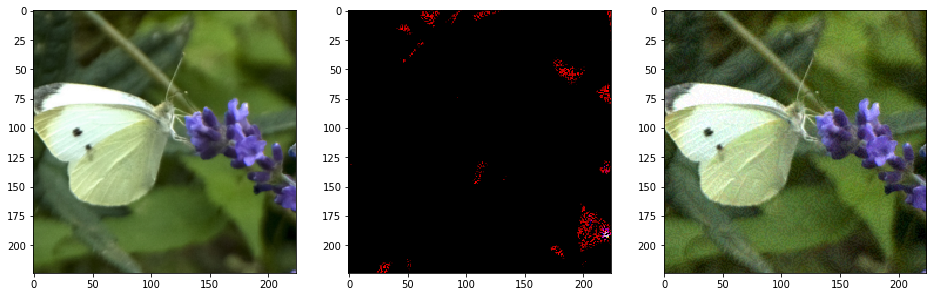

ringlet, ringlet butterfly
using model type: z

Original image predictions:
ear, spike, capitulum (998): 0.3295303285121918
daisy (985): 0.09071464836597443
sea anemone, anemone (108): 0.06706930696964264
banana (954): 0.060240257531404495
corn (987): 0.05891565978527069

Generating adversarial example
L2: 38.771423

Adversarial image predictions:
swab, swob, mop (840): 0.16185633838176727
cardigan (474): 0.09828333556652069
dragonfly, darning needle, devil's darning needle, sewing needle, snake feeder, snake doctor, mosquito hawk, skeeter hawk (319): 0.08131331950426102
sarong (775): 0.0675298199057579
American chameleon, anole, Anolis carolinensis (40): 0.06741683185100555


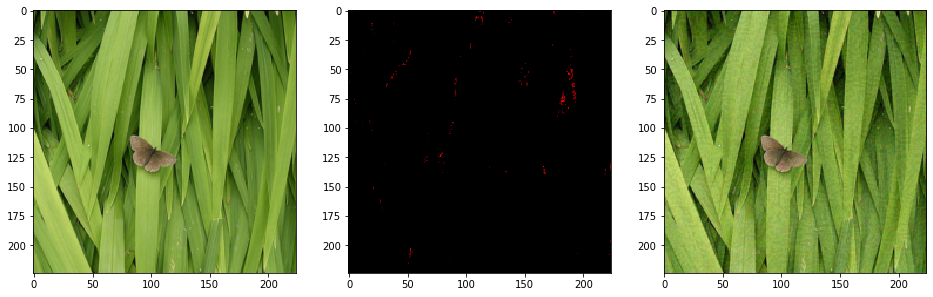

using model type: s

Original image predictions:
ringlet, ringlet butterfly (322): 0.10347674041986465
banana (954): 0.060918960720300674
bittern (133): 0.04453015699982643
yellow lady's slipper, yellow lady-slipper, Cypripedium calceolus, Cypripedium parviflorum (986): 0.04204907640814781
pineapple, ananas (953): 0.035374123603105545

Generating adversarial example
L2: 38.775345

Adversarial image predictions:
banana (954): 0.1676713079214096
pineapple, ananas (953): 0.052210453897714615
ear, spike, capitulum (998): 0.04575628042221069
corn (987): 0.03940798342227936
pot, flowerpot (738): 0.03729507327079773


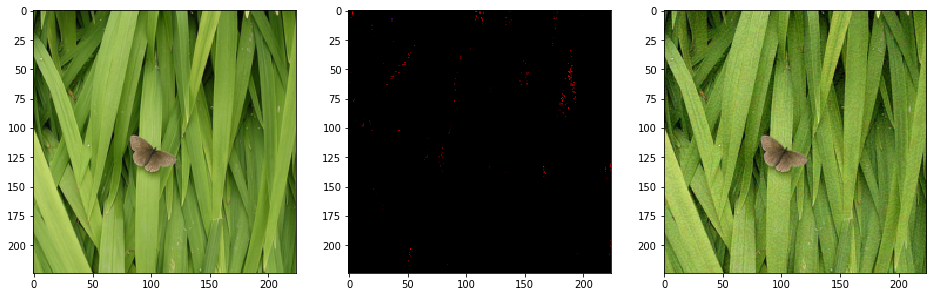

oscilloscope, scope, cathode-ray oscilloscope, CRO
using model type: z

Original image predictions:
oscilloscope, scope, cathode-ray oscilloscope, CRO (688): 0.9785705804824829
remote control, remote (761): 0.007346039637923241
cellular telephone, cellular phone, cellphone, cell, mobile phone (487): 0.003420297522097826
radio, wireless (754): 0.0015495449770241976
hard disc, hard disk, fixed disk (592): 0.001528009888716042

Generating adversarial example
L2: 38.723385

Adversarial image predictions:
pay-phone, pay-station (707): 0.19674904644489288
remote control, remote (761): 0.15953095257282257
rule, ruler (769): 0.13477225601673126
parking meter (704): 0.06364921480417252
cellular telephone, cellular phone, cellphone, cell, mobile phone (487): 0.05614635348320007


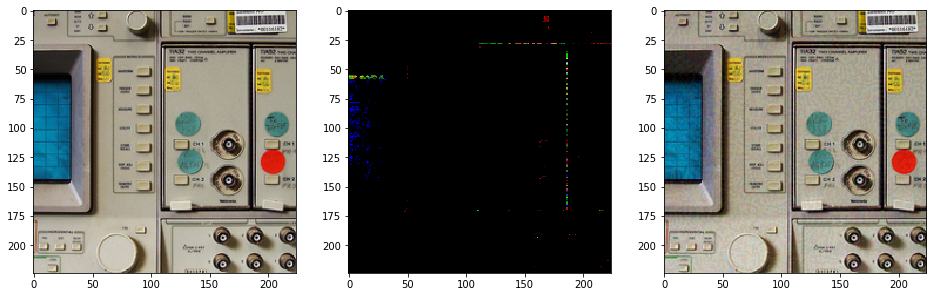

using model type: s

Original image predictions:
oscilloscope, scope, cathode-ray oscilloscope, CRO (688): 0.9998783469200134
radio, wireless (754): 8.412940223934129e-05
screen, CRT screen (782): 9.780662367120385e-06
hand-held computer, hand-held microcomputer (590): 5.458844952954678e-06
switch, electric switch, electrical switch (844): 4.211893156025326e-06

Generating adversarial example
L2: 38.7244

Adversarial image predictions:
mailbox, letter box (637): 0.2505853772163391
pay-phone, pay-station (707): 0.08322113752365112
radio, wireless (754): 0.06997354328632355
oscilloscope, scope, cathode-ray oscilloscope, CRO (688): 0.05507563054561615
parking meter (704): 0.04796233028173447


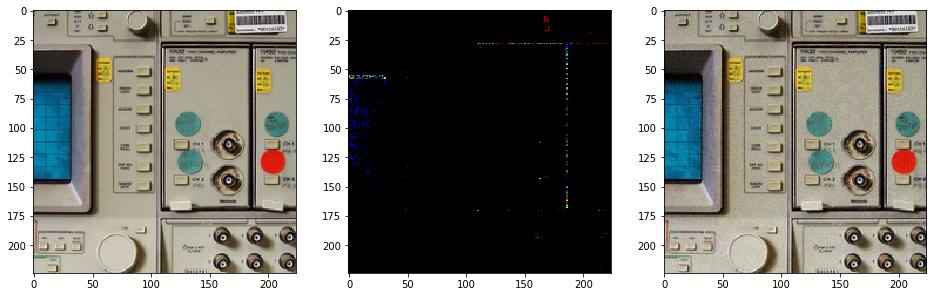

grand piano, grand
using model type: z

Original image predictions:
dining table, board (532): 0.5798200368881226
grand piano, grand (579): 0.18042831122875214
restaurant, eating house, eating place, eatery (762): 0.022909415885806084
rocking chair, rocker (765): 0.021403426304459572
folding chair (559): 0.01700633205473423

Generating adversarial example
L2: 38.794754

Adversarial image predictions:
water buffalo, water ox, Asiatic buffalo, Bubalus bubalis (346): 0.2954328954219818
plow, plough (730): 0.09865250438451767
oxcart (690): 0.08093725889921188
ox (345): 0.07041372358798981
hog, pig, grunter, squealer, Sus scrofa (341): 0.05548891797661781


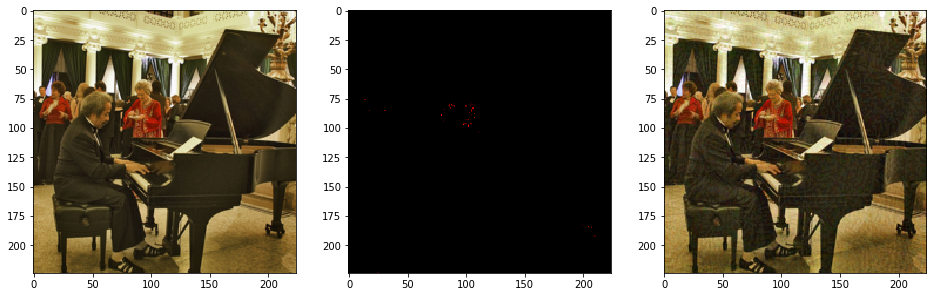

using model type: s

Original image predictions:
grand piano, grand (579): 0.9905727505683899
upright, upright piano (881): 0.004679548554122448
cello, violoncello (486): 0.0015684767859056592
library (624): 0.0009234389290213585
bassoon (432): 0.0006729729357175529

Generating adversarial example
L2: 38.79325

Adversarial image predictions:
bassoon (432): 0.1510063111782074
cello, violoncello (486): 0.1270553320646286
accordion, piano accordion, squeeze box (401): 0.07934172451496124
restaurant, eating house, eating place, eatery (762): 0.06045493483543396
library (624): 0.05070289596915245


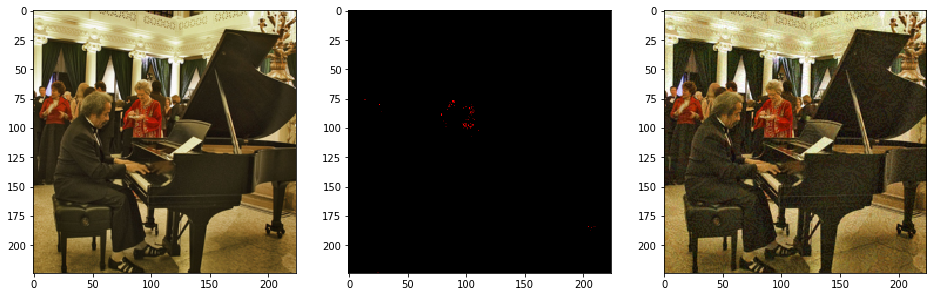

fountain
using model type: z

Original image predictions:
fountain (562): 0.5704610347747803
picket fence, paling (716): 0.1412317305803299
organ, pipe organ (687): 0.06666932255029678
matchstick (644): 0.03998376429080963
theater curtain, theatre curtain (854): 0.0368342399597168

Generating adversarial example
L2: 37.11101

Adversarial image predictions:
picket fence, paling (716): 0.4575655460357666
organ, pipe organ (687): 0.12779927253723145
worm fence, snake fence, snake-rail fence, Virginia fence (912): 0.09056269377470016
radiator (753): 0.024660974740982056
hammer (587): 0.018244214355945587


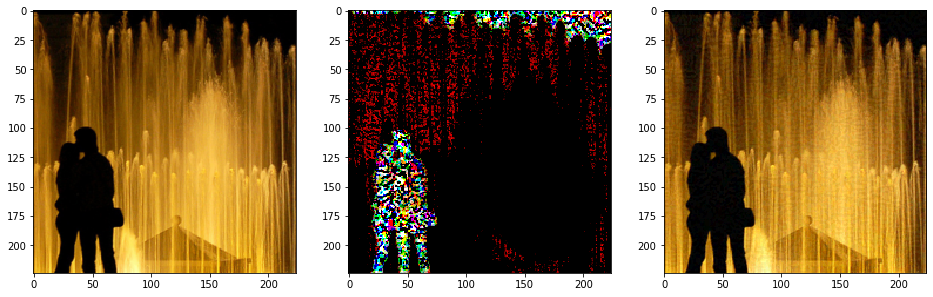

using model type: s

Original image predictions:
fountain (562): 0.9999978542327881
theater curtain, theatre curtain (854): 1.0668213690223638e-06
geyser (974): 7.014076004452363e-07
fireboat (554): 9.944450596321985e-08
picket fence, paling (716): 7.021493786396604e-08

Generating adversarial example
L2: 37.091232

Adversarial image predictions:
theater curtain, theatre curtain (854): 0.9362441897392273
window shade (905): 0.012596667744219303
groom, bridegroom (982): 0.006651490461081266
fountain (562): 0.004941408056765795
grand piano, grand (579): 0.0032729855738580227


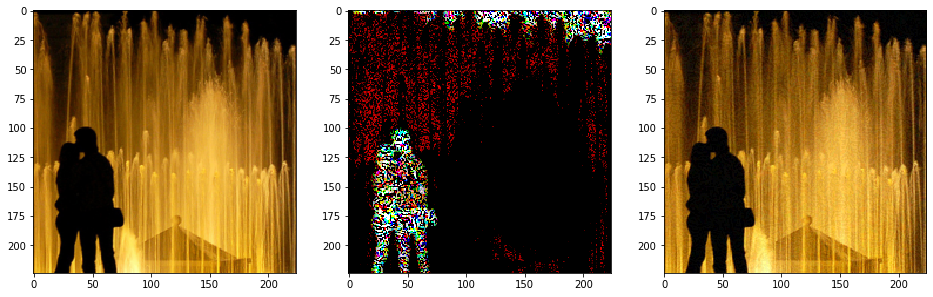

comic book
using model type: z

Original image predictions:
fox squirrel, eastern fox squirrel, Sciurus niger (335): 0.5832014083862305
dingo, warrigal, warragal, Canis dingo (273): 0.13913972675800323
dhole, Cuon alpinus (274): 0.06320802867412567
red fox, Vulpes vulpes (277): 0.05109553411602974
hog, pig, grunter, squealer, Sus scrofa (341): 0.029007714241743088

Generating adversarial example
L2: 38.63234

Adversarial image predictions:
dingo, warrigal, warragal, Canis dingo (273): 0.8674300909042358
Saluki, gazelle hound (176): 0.042100053280591965
beagle (162): 0.015018395148217678
basset, basset hound (161): 0.012888568453490734
dhole, Cuon alpinus (274): 0.011974850669503212


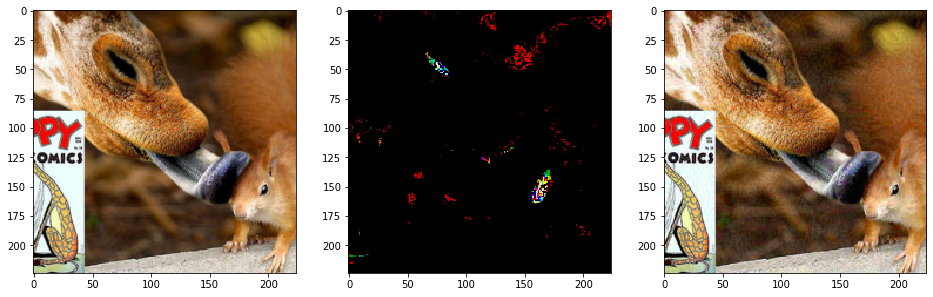

using model type: s

Original image predictions:
frilled lizard, Chlamydosaurus kingi (43): 0.0883600264787674
wallaby, brush kangaroo (104): 0.06767824292182922
dingo, warrigal, warragal, Canis dingo (273): 0.05062040314078331
hare (331): 0.048000603914260864
wood rabbit, cottontail, cottontail rabbit (330): 0.04711417853832245

Generating adversarial example
L2: 38.629467

Adversarial image predictions:
hog, pig, grunter, squealer, Sus scrofa (341): 0.28658270835876465
bluetick (164): 0.07739611715078354
basenji (253): 0.06314405053853989
hare (331): 0.04858457297086716
Walker hound, Walker foxhound (166): 0.040654949843883514


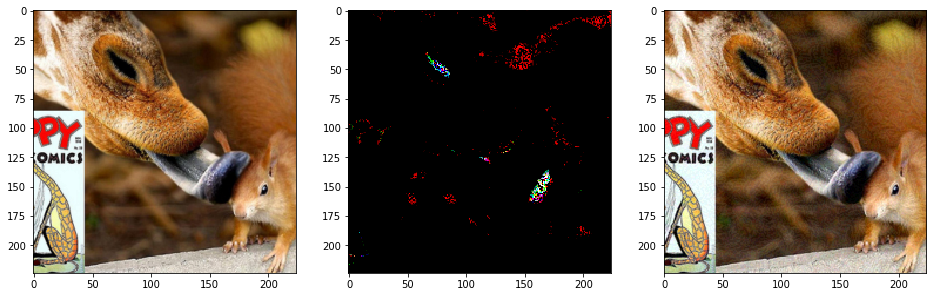

snowplow, snowplough
using model type: z

Original image predictions:
snowplow, snowplough (803): 0.21768280863761902
pool table, billiard table, snooker table (736): 0.11239694803953171
limousine, limo (627): 0.07405076920986176
obelisk (682): 0.06426528841257095
spotlight, spot (818): 0.060631293803453445

Generating adversarial example
L2: 36.959625

Adversarial image predictions:
candle, taper, wax light (470): 0.1715267151594162
torch (862): 0.06523184478282928
spotlight, spot (818): 0.05643575266003609
pool table, billiard table, snooker table (736): 0.052069395780563354
teapot (849): 0.0459030382335186


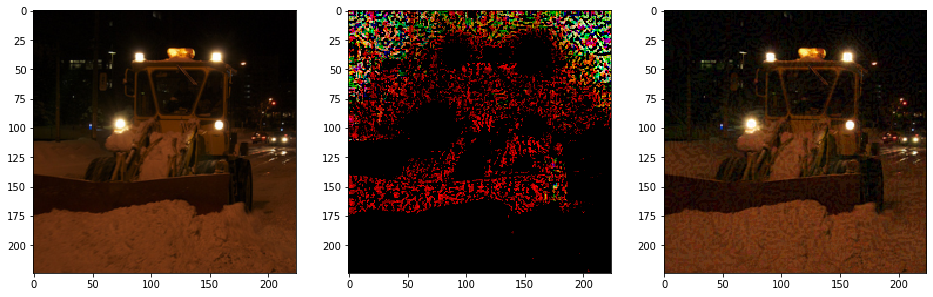

using model type: s

Original image predictions:
snowplow, snowplough (803): 0.9916985034942627
tow truck, tow car, wrecker (864): 0.004839618690311909
plow, plough (730): 0.0011486050207167864
fire engine, fire truck (555): 0.0007781699532642961
tractor (866): 0.0004782106261700392

Generating adversarial example
L2: 36.96965

Adversarial image predictions:
torch (862): 0.9894768595695496
spotlight, spot (818): 0.0008345248061232269
candle, taper, wax light (470): 0.000704913109075278
tow truck, tow car, wrecker (864): 0.0005095325759612024
plow, plough (730): 0.0004716727416962385


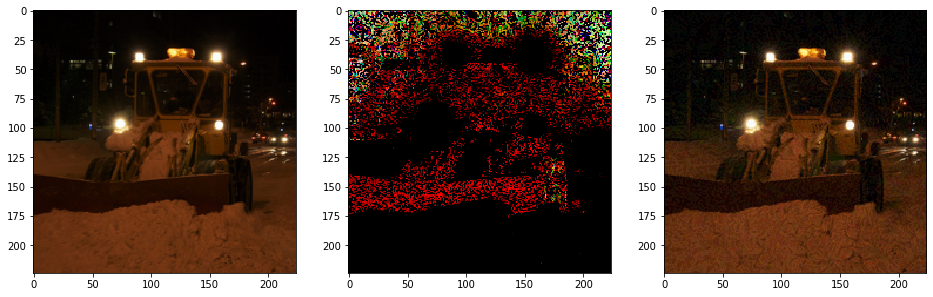

totem pole
using model type: z

Original image predictions:
totem pole (863): 0.9388241171836853
banjo (420): 0.018062444403767586
harp (594): 0.006003725342452526
pole (733): 0.005792427808046341
bassoon (432): 0.004832250997424126

Generating adversarial example
L2: 38.699398

Adversarial image predictions:
bassoon (432): 0.7074212431907654
banjo (420): 0.19914454221725464
sax, saxophone (776): 0.06535563617944717
oboe, hautboy, hautbois (683): 0.023466473445296288
electric guitar (546): 0.001222641090862453


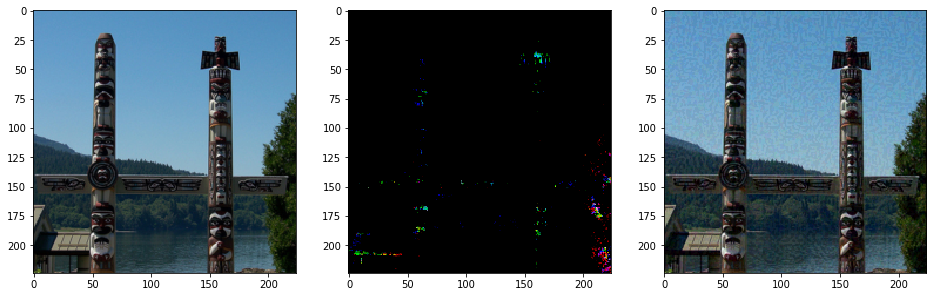

using model type: s

Original image predictions:
totem pole (863): 0.9971137642860413
pole (733): 0.0028832871466875076
crane (517): 4.560227750971535e-07
traffic light, traffic signal, stoplight (920): 3.8924909517845663e-07
street sign (919): 3.82125335818273e-07

Generating adversarial example
L2: 38.686123

Adversarial image predictions:
totem pole (863): 0.5417805314064026
pole (733): 0.4423861503601074
beacon, lighthouse, beacon light, pharos (437): 0.0016039639012888074
mosque (668): 0.0009728022268973291
scabbard (777): 0.0005778809427283704


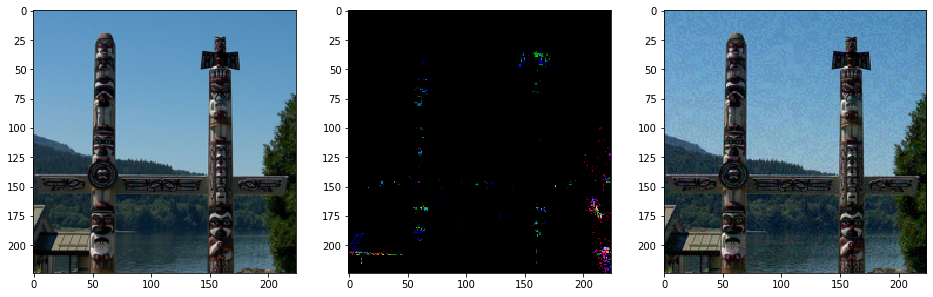

alligator lizard
using model type: z

Original image predictions:
alligator lizard (44): 0.5231249928474426
harvestman, daddy longlegs, Phalangium opilio (70): 0.16905879974365234
night snake, Hypsiglena torquata (60): 0.11969147622585297
lacewing, lacewing fly (318): 0.03243611380457878
wolf spider, hunting spider (77): 0.028986945748329163

Generating adversarial example
L2: 38.79765

Adversarial image predictions:
harvestman, daddy longlegs, Phalangium opilio (70): 0.994668185710907
ant, emmet, pismire (310): 0.0022516585886478424
long-horned beetle, longicorn, longicorn beetle (303): 0.0008924607536755502
wolf spider, hunting spider (77): 0.0006391769275069237
cockroach, roach (314): 0.00032251718221232295


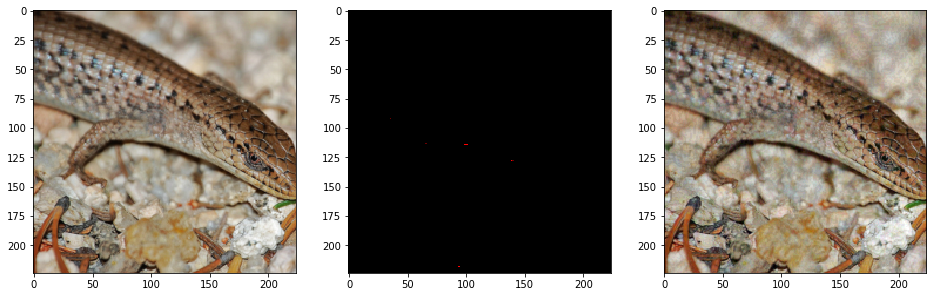

using model type: s

Original image predictions:
alligator lizard (44): 0.974817156791687
whiptail, whiptail lizard (41): 0.016933538019657135
common newt, Triturus vulgaris (26): 0.0028805206529796124
thunder snake, worm snake, Carphophis amoenus (52): 0.002435908652842045
night snake, Hypsiglena torquata (60): 0.0010712301591411233

Generating adversarial example
L2: 38.79744

Adversarial image predictions:
whiptail, whiptail lizard (41): 0.20131292939186096
common newt, Triturus vulgaris (26): 0.11938299238681793
eel (390): 0.06318787485361099
thunder snake, worm snake, Carphophis amoenus (52): 0.05213310942053795
slug (114): 0.05057520791888237


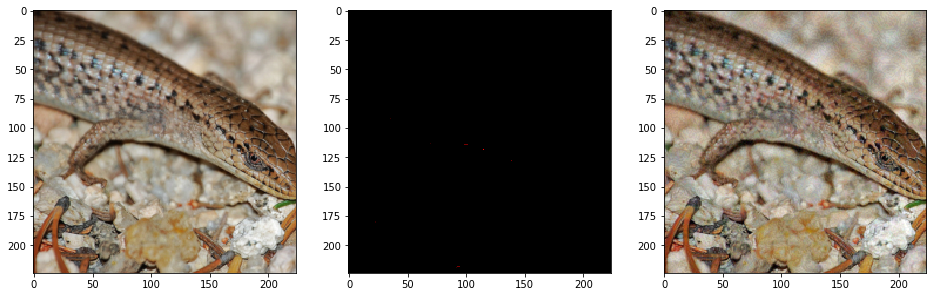

piggy bank, penny bank
using model type: z

Original image predictions:
piggy bank, penny bank (719): 0.5087236762046814
acorn (988): 0.13693666458129883
conch (112): 0.06253980100154877
pomegranate (957): 0.05151443928480148
bolete (997): 0.03632202744483948

Generating adversarial example
L2: 38.794376

Adversarial image predictions:
acorn (988): 0.8622435927391052
chiton, coat-of-mail shell, sea cradle, polyplacophore (116): 0.041509754955768585
bolete (997): 0.023099999874830246
snail (113): 0.01783614046871662
fig (952): 0.014597693458199501


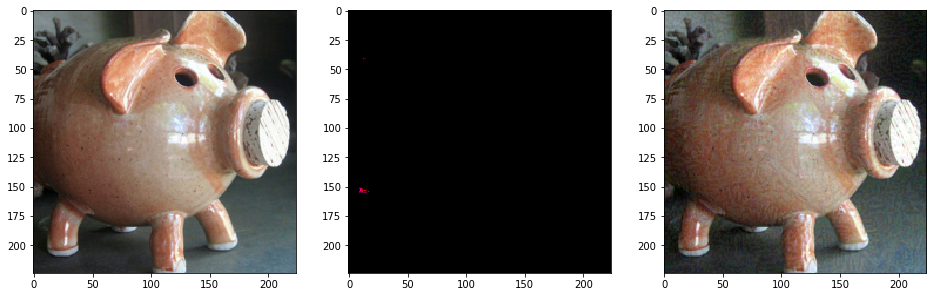

using model type: s

Original image predictions:
piggy bank, penny bank (719): 0.9996457099914551
ocarina, sweet potato (684): 0.00028032358386553824
teapot (849): 5.0748691137414426e-05
pitcher, ewer (725): 6.24943550064927e-06
hippopotamus, hippo, river horse, Hippopotamus amphibius (344): 5.009905635233736e-06

Generating adversarial example
L2: 38.793613

Adversarial image predictions:
ocarina, sweet potato (684): 0.889833927154541
teapot (849): 0.012965886853635311
piggy bank, penny bank (719): 0.012862433679401875
spindle (816): 0.006742659956216812
acorn (988): 0.006415179930627346


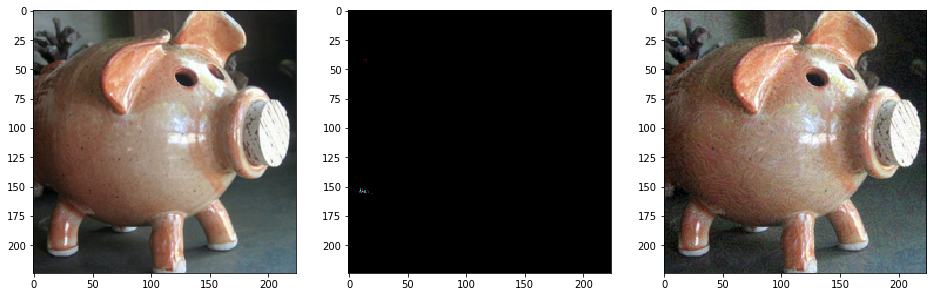

bulbul
using model type: z

Original image predictions:
redshank, Tringa totanus (141): 0.2832086682319641
house finch, linnet, Carpodacus mexicanus (12): 0.10708685964345932
bulbul (16): 0.0929635539650917
ruffed grouse, partridge, Bonasa umbellus (82): 0.07197065651416779
hen (8): 0.053846653550863266

Generating adversarial example
L2: 38.565437

Adversarial image predictions:
hen (8): 0.4349403977394104
house finch, linnet, Carpodacus mexicanus (12): 0.26531317830085754
cock (7): 0.1609993278980255
ruffed grouse, partridge, Bonasa umbellus (82): 0.018257981166243553
partridge (86): 0.009994078427553177


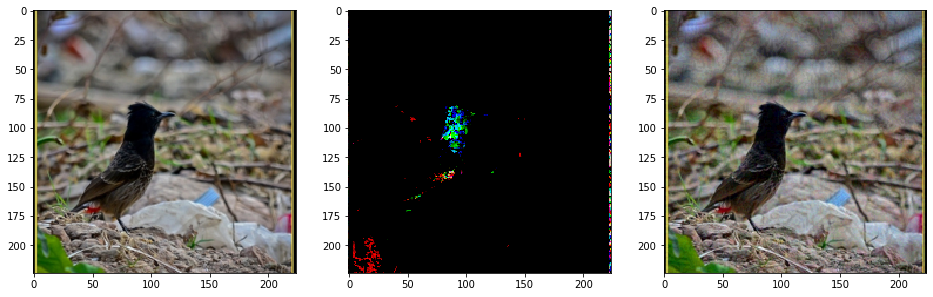

using model type: s

Original image predictions:
bulbul (16): 0.9897628426551819
robin, American robin, Turdus migratorius (15): 0.004370977636426687
quail (85): 0.002514416119083762
ruffed grouse, partridge, Bonasa umbellus (82): 0.0007427200325764716
water ouzel, dipper (20): 0.0006544312927871943

Generating adversarial example
L2: 38.56639

Adversarial image predictions:
brambling, Fringilla montifringilla (10): 0.3296090066432953
robin, American robin, Turdus migratorius (15): 0.1874791383743286
quail (85): 0.1852177381515503
ruffed grouse, partridge, Bonasa umbellus (82): 0.10979115962982178
partridge (86): 0.07170020043849945


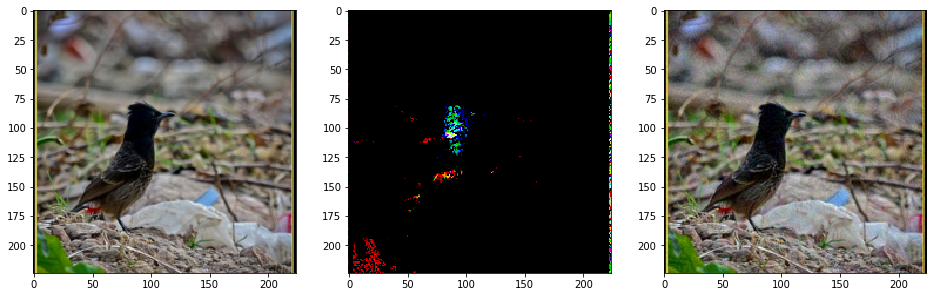

indri, indris, Indri indri, Indri brevicaudatus
using model type: z

Original image predictions:
guinea pig, Cavia cobaya (338): 0.4636582136154175
skunk, polecat, wood pussy (361): 0.3171626031398773
hamster (333): 0.08103276044130325
tiger cat (282): 0.014404607936739922
black-footed ferret, ferret, Mustela nigripes (359): 0.014328771270811558

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
skunk, polecat, wood pussy (361): 0.9985322952270508
Siberian husky (250): 0.00034178877831436694
malamute, malemute, Alaskan malamute (249): 0.00032319140154868364
Madagascar cat, ring-tailed lemur, Lemur catta (383): 0.00019726340542547405
badger (362): 0.00016162722022272646


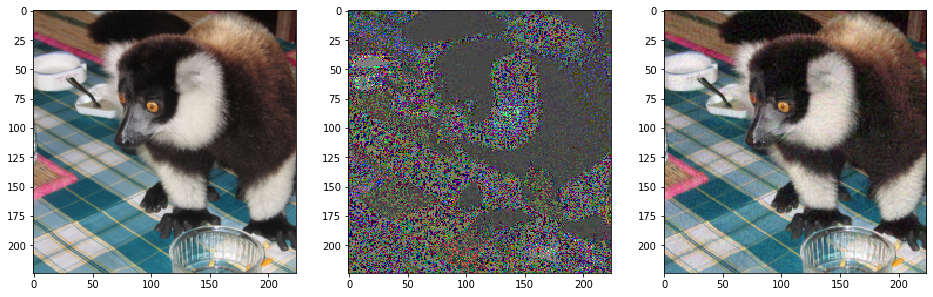

using model type: s

Original image predictions:
indri, indris, Indri indri, Indri brevicaudatus (384): 0.4897459149360657
Madagascar cat, ring-tailed lemur, Lemur catta (383): 0.3861306607723236
skunk, polecat, wood pussy (361): 0.03586412966251373
Siberian husky (250): 0.018762020394206047
titi, titi monkey (380): 0.008515208959579468

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
guinea pig, Cavia cobaya (338): 0.46600010991096497
doormat, welcome mat (539): 0.09083767235279083
skunk, polecat, wood pussy (361): 0.06494652479887009
Siberian husky (250): 0.0246539656072855
jigsaw puzzle (611): 0.019556056708097458


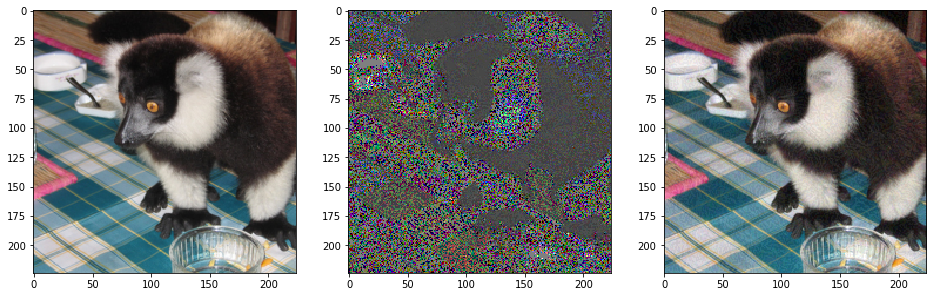

sea urchin
using model type: z

Original image predictions:
chiton, coat-of-mail shell, sea cradle, polyplacophore (116): 0.15994414687156677
sea urchin (328): 0.11796814948320389
starfish, sea star (327): 0.07135750353336334
sea slug, nudibranch (115): 0.05820581316947937
snail (113): 0.05739929527044296

Generating adversarial example
L2: 38.760403

Adversarial image predictions:
echidna, spiny anteater, anteater (102): 0.39826682209968567
porcupine, hedgehog (334): 0.08777492493391037
yellow lady's slipper, yellow lady-slipper, Cypripedium calceolus, Cypripedium parviflorum (986): 0.030221156775951385
peacock (84): 0.0289419237524271
cardoon (946): 0.028894102200865746


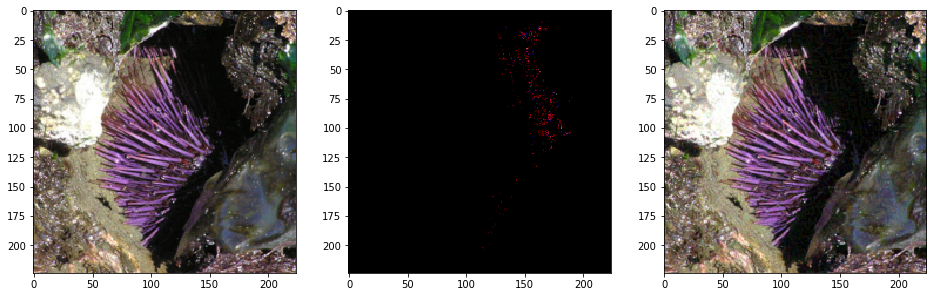

using model type: s

Original image predictions:
sea urchin (328): 0.4627577066421509
chiton, coat-of-mail shell, sea cradle, polyplacophore (116): 0.2855628728866577
sea anemone, anemone (108): 0.19173870980739594
starfish, sea star (327): 0.014793256297707558
sea slug, nudibranch (115): 0.008502054959535599

Generating adversarial example
L2: 38.75741

Adversarial image predictions:
chiton, coat-of-mail shell, sea cradle, polyplacophore (116): 0.46505868434906006
flatworm, platyhelminth (110): 0.13597320020198822
slug (114): 0.1230003833770752
eel (390): 0.07332447916269302
sea anemone, anemone (108): 0.05417292192578316


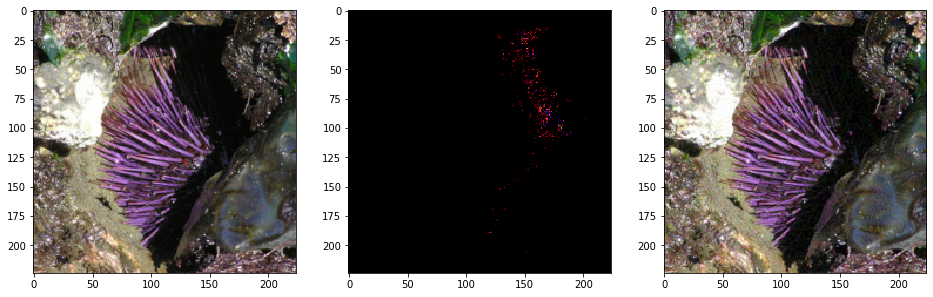

ram, tup
using model type: z

Original image predictions:
Great Dane (246): 0.17859651148319244
llama (355): 0.07644734531641006
kelpie (227): 0.06079002097249031
Staffordshire bullterrier, Staffordshire bull terrier (179): 0.055073462426662445
Afghan hound, Afghan (160): 0.05473792552947998

Generating adversarial example
L2: 38.79773

Adversarial image predictions:
llama (355): 0.1942208856344223
affenpinscher, monkey pinscher, monkey dog (252): 0.05654624477028847
cairn, cairn terrier (192): 0.056023165583610535
hare (331): 0.05391005054116249
miniature schnauzer (196): 0.0493985116481781


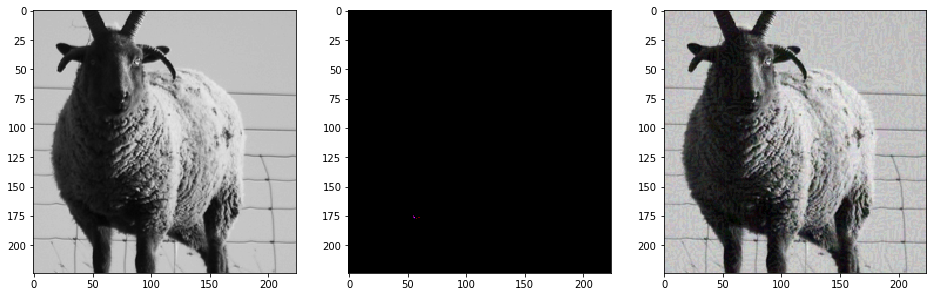

using model type: s

Original image predictions:
ram, tup (348): 0.9459069967269897
bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis (349): 0.028270984068512917
ibex, Capra ibex (350): 0.013556897640228271
llama (355): 0.004270242992788553
hare (331): 0.0009488509385846555

Generating adversarial example
L2: 38.797947

Adversarial image predictions:
ibex, Capra ibex (350): 0.1251865178346634
triceratops (51): 0.03537806123495102
fountain (562): 0.033136941492557526
pedestal, plinth, footstall (708): 0.02434922195971012
Egyptian cat (285): 0.021515754982829094


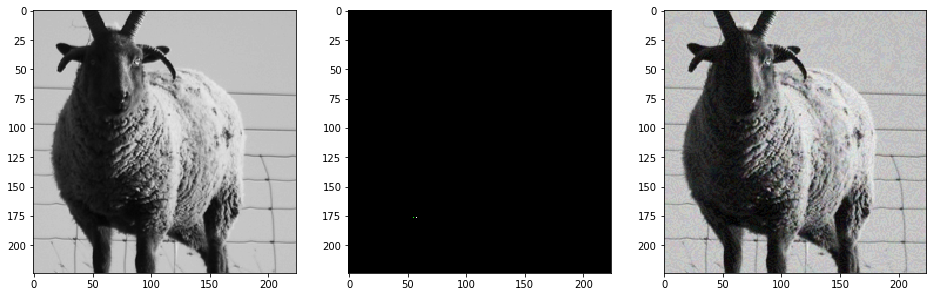

Dandie Dinmont, Dandie Dinmont terrier
using model type: z

Original image predictions:
Sealyham terrier, Sealyham (190): 0.29607877135276794
Dandie Dinmont, Dandie Dinmont terrier (194): 0.10341651737689972
Bedlington terrier (181): 0.09114290773868561
llama (355): 0.08772420138120651
Old English sheepdog, bobtail (229): 0.05046289786696434

Generating adversarial example
L2: 38.79805

Adversarial image predictions:
Madagascar cat, ring-tailed lemur, Lemur catta (383): 0.39113375544548035
llama (355): 0.16966718435287476
gibbon, Hylobates lar (368): 0.08342798054218292
baboon (372): 0.06290313601493835
langur (374): 0.06117060407996178


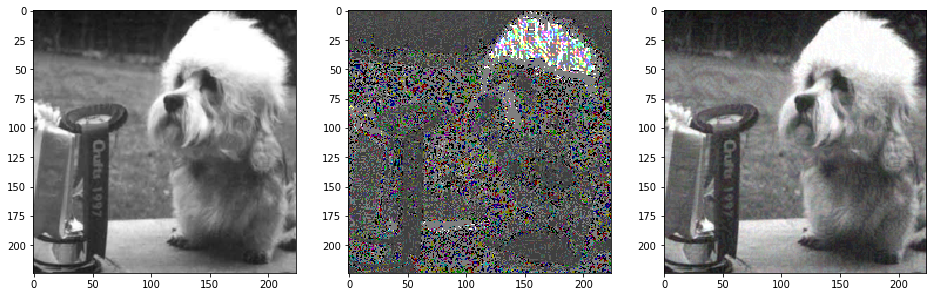

using model type: s

Original image predictions:
Dandie Dinmont, Dandie Dinmont terrier (194): 0.9703492522239685
toy poodle (265): 0.003105485811829567
Pekinese, Pekingese, Peke (154): 0.002909390488639474
miniature poodle (266): 0.0025499393232166767
Shih-Tzu (155): 0.0024096749257296324

Generating adversarial example
L2: 38.79805

Adversarial image predictions:
colobus, colobus monkey (375): 0.11907804757356644
marmoset (377): 0.07899793237447739
Pekinese, Pekingese, Peke (154): 0.04568364471197128
cocker spaniel, English cocker spaniel, cocker (219): 0.04245664179325104
guenon, guenon monkey (370): 0.038182422518730164


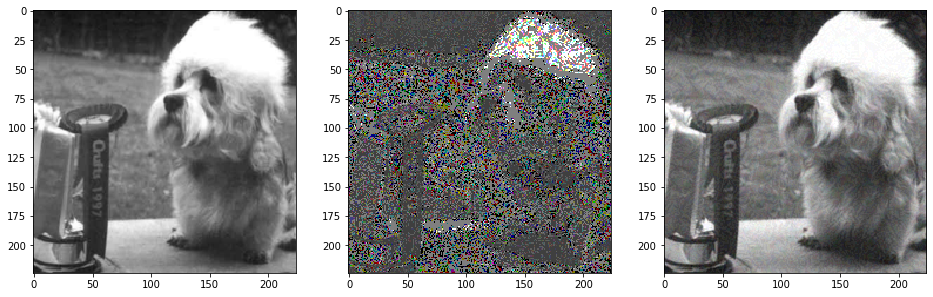

neck brace
using model type: z

Original image predictions:
neck brace (678): 0.1352563351392746
bow tie, bow-tie, bowtie (457): 0.10182137787342072
brassiere, bra, bandeau (459): 0.059137940406799316
cowboy hat, ten-gallon hat (515): 0.05517553165555
sunglasses, dark glasses, shades (837): 0.053953446447849274

Generating adversarial example
L2: 38.71116

Adversarial image predictions:
triceratops (51): 0.26169100403785706
armadillo (363): 0.17505665123462677
bow tie, bow-tie, bowtie (457): 0.0767035260796547
sombrero (808): 0.05881023779511452
panpipe, pandean pipe, syrinx (699): 0.037896834313869476


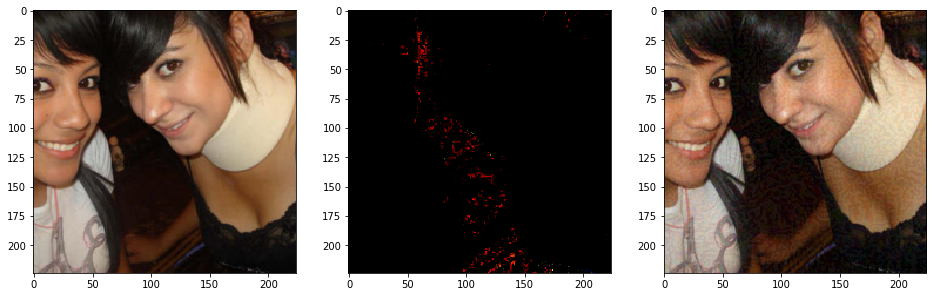

using model type: s

Original image predictions:
neck brace (678): 0.28133243322372437
wig (903): 0.12441987544298172
brassiere, bra, bandeau (459): 0.06664172559976578
bow tie, bow-tie, bowtie (457): 0.05028597265481949
bonnet, poke bonnet (452): 0.04557400196790695

Generating adversarial example
L2: 38.701675

Adversarial image predictions:
candle, taper, wax light (470): 0.398862361907959
bow tie, bow-tie, bowtie (457): 0.10427863895893097
wig (903): 0.06774076819419861
bolo tie, bolo, bola tie, bola (451): 0.04206336289644241
cowboy hat, ten-gallon hat (515): 0.03604018688201904


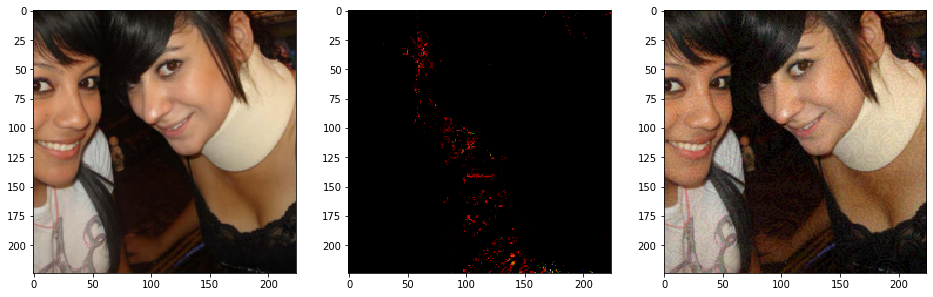

harmonica, mouth organ, harp, mouth harp
using model type: z

Original image predictions:
bassoon (432): 0.2519468367099762
flute, transverse flute (558): 0.16345877945423126
trombone (875): 0.04975398629903793
sax, saxophone (776): 0.04223649203777313
harmonica, mouth organ, harp, mouth harp (593): 0.04015218839049339

Generating adversarial example
L2: 37.721973

Adversarial image predictions:
chest (492): 0.09984240680932999
crate (519): 0.041340213268995285
safe (771): 0.03559907153248787
monastery (663): 0.034575946629047394
barrel, cask (427): 0.03131764009594917


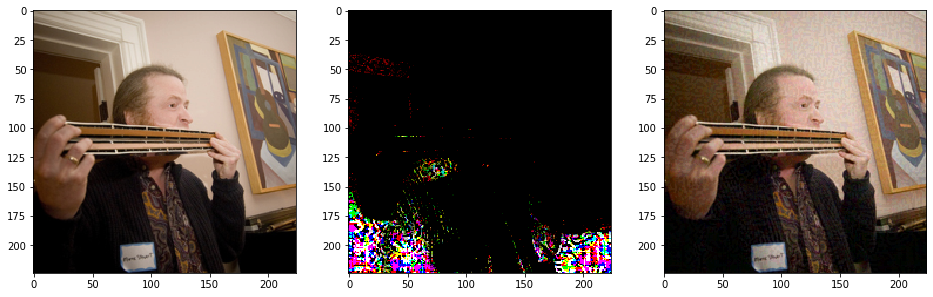

using model type: s

Original image predictions:
harmonica, mouth organ, harp, mouth harp (593): 0.9751092195510864
flute, transverse flute (558): 0.02288806065917015
panpipe, pandean pipe, syrinx (699): 0.0007644437137059867
cornet, horn, trumpet, trump (513): 0.00043757990351878107
ocarina, sweet potato (684): 0.00011648422514554113

Generating adversarial example
L2: 37.717396

Adversarial image predictions:
cornet, horn, trumpet, trump (513): 0.5645105838775635
flute, transverse flute (558): 0.2538147270679474
trombone (875): 0.17166464030742645
French horn, horn (566): 0.0058116610161960125
sax, saxophone (776): 0.0014324552612379193


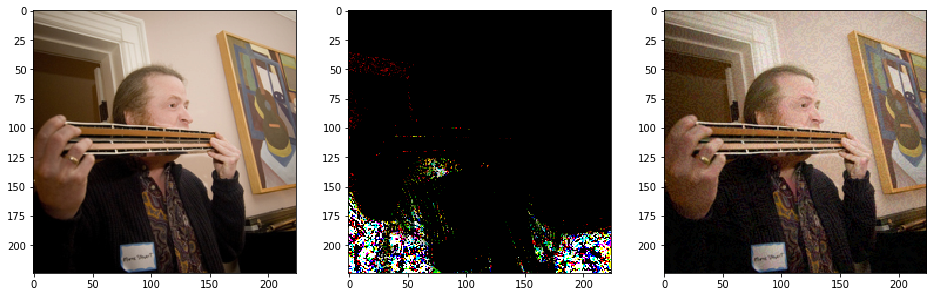

ostrich, Struthio camelus
using model type: z

Original image predictions:
ostrich, Struthio camelus (9): 0.9377299547195435
langur (374): 0.03334997966885567
patas, hussar monkey, Erythrocebus patas (371): 0.00656353821977973
Saluki, gazelle hound (176): 0.00602897210046649
Madagascar cat, ring-tailed lemur, Lemur catta (383): 0.004126505460590124

Generating adversarial example
L2: 38.79479

Adversarial image predictions:
langur (374): 0.9379127025604248
spider monkey, Ateles geoffroyi (381): 0.010094513185322285
patas, hussar monkey, Erythrocebus patas (371): 0.009930101223289967
guenon, guenon monkey (370): 0.009816022589802742
gibbon, Hylobates lar (368): 0.007249030750244856


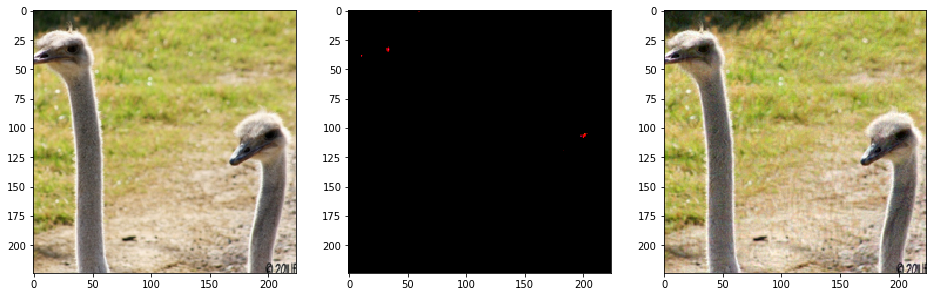

using model type: s

Original image predictions:
ostrich, Struthio camelus (9): 0.9999957084655762
bustard (138): 2.5440322133363225e-06
crane (134): 1.622324930394825e-06
vulture (23): 3.572371909399408e-08
peacock (84): 2.551511002479856e-08

Generating adversarial example
L2: 38.79442

Adversarial image predictions:
crane (134): 0.5807043313980103
bustard (138): 0.09379146993160248
ostrich, Struthio camelus (9): 0.08036139607429504
goose (99): 0.036111053079366684
American egret, great white heron, Egretta albus (132): 0.033359114080667496


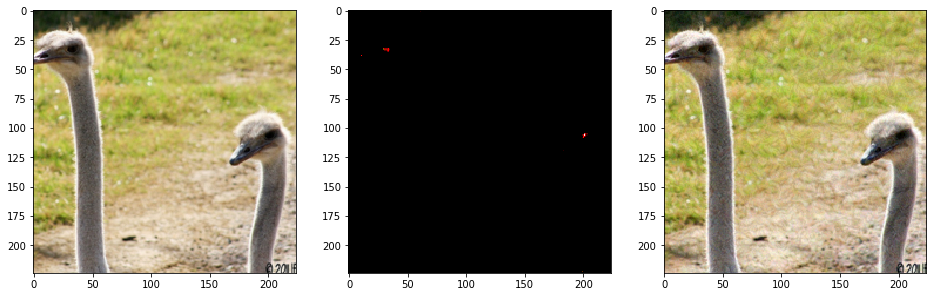

patas, hussar monkey, Erythrocebus patas
using model type: z

Original image predictions:
marmoset (377): 0.3183802366256714
Irish setter, red setter (213): 0.15324406325817108
titi, titi monkey (380): 0.07841046899557114
Yorkshire terrier (187): 0.07294634729623795
langur (374): 0.0669957846403122

Generating adversarial example
L2: 38.628654

Adversarial image predictions:
Irish setter, red setter (213): 0.957841694355011
golden retriever (207): 0.024747071787714958
Irish terrier (184): 0.008804271928966045
Norfolk terrier (185): 0.002308937720954418
cocker spaniel, English cocker spaniel, cocker (219): 0.0019745586905628443


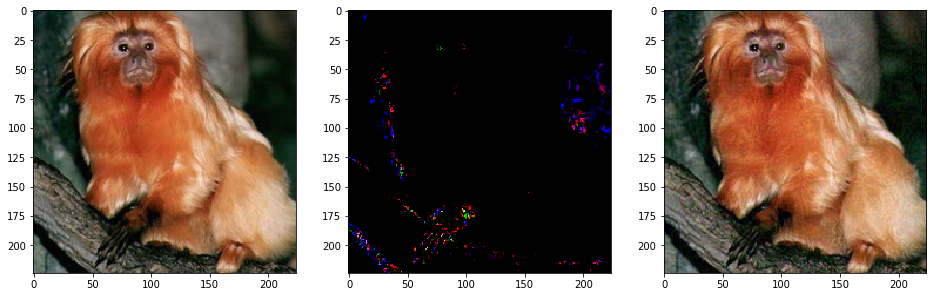

using model type: s

Original image predictions:
marmoset (377): 0.8023662567138672
titi, titi monkey (380): 0.16534645855426788
langur (374): 0.008504941128194332
howler monkey, howler (379): 0.00817169900983572
patas, hussar monkey, Erythrocebus patas (371): 0.00288375117816031

Generating adversarial example
L2: 38.641136

Adversarial image predictions:
howler monkey, howler (379): 0.6618092060089111
titi, titi monkey (380): 0.10430628061294556
orangutan, orang, orangutang, Pongo pygmaeus (365): 0.04556308314204216
patas, hussar monkey, Erythrocebus patas (371): 0.03967224806547165
gibbon, Hylobates lar (368): 0.03159760683774948


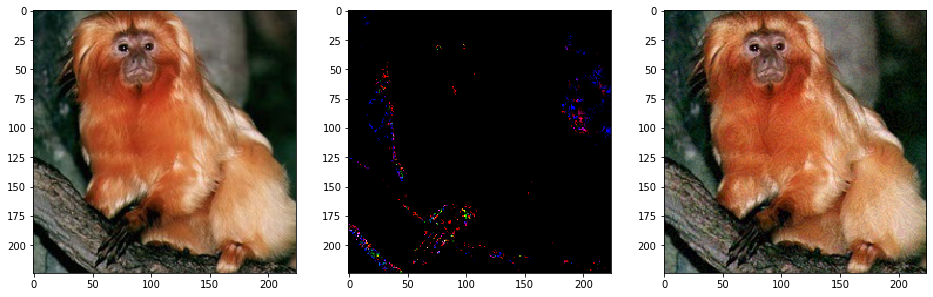

European fire salamander, Salamandra salamandra
using model type: z

Original image predictions:
European fire salamander, Salamandra salamandra (25): 0.9235694408416748
spotted salamander, Ambystoma maculatum (28): 0.07405658811330795
centipede (79): 0.0008471694309264421
common newt, Triturus vulgaris (26): 0.0006241407245397568
stinkhorn, carrion fungus (994): 0.00018712671590037644

Generating adversarial example
L2: 38.70316

Adversarial image predictions:
spotted salamander, Ambystoma maculatum (28): 0.9996968507766724
centipede (79): 9.289158333558589e-05
common newt, Triturus vulgaris (26): 9.106370998779312e-05
scorpion (71): 2.645388121891301e-05
American lobster, Northern lobster, Maine lobster, Homarus americanus (122): 9.303772458224557e-06


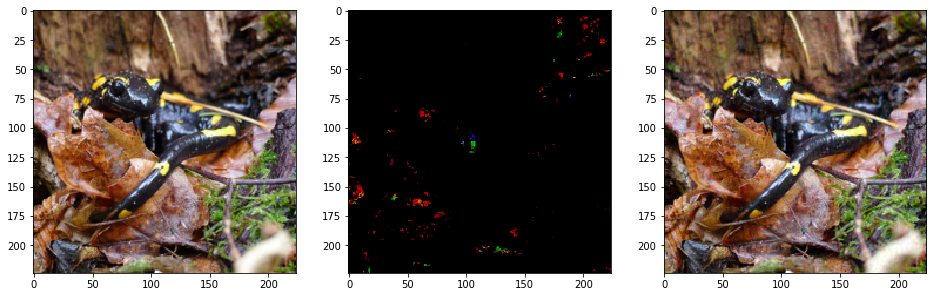

using model type: s

Original image predictions:
European fire salamander, Salamandra salamandra (25): 0.9602393507957458
spotted salamander, Ambystoma maculatum (28): 0.03327271342277527
common newt, Triturus vulgaris (26): 0.004232495557516813
eft (27): 0.0008731166599318385
honeycomb (599): 0.0003052612009923905

Generating adversarial example
L2: 38.70584

Adversarial image predictions:
spotted salamander, Ambystoma maculatum (28): 0.4405595362186432
eft (27): 0.09420359134674072
common newt, Triturus vulgaris (26): 0.0920276865363121
European fire salamander, Salamandra salamandra (25): 0.06744357198476791
garter snake, grass snake (57): 0.02626185119152069


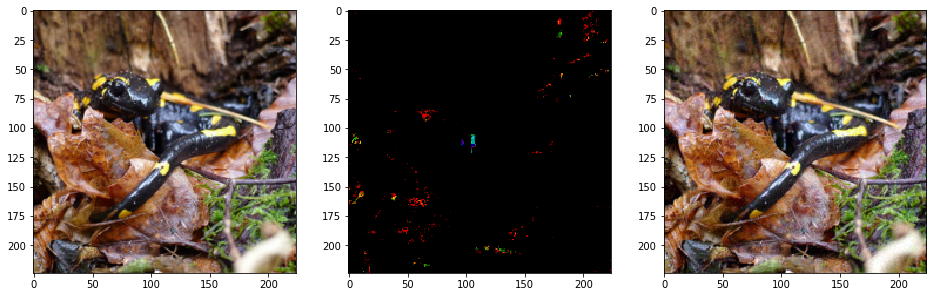

wreck
using model type: z

Original image predictions:
scuba diver (983): 0.4791862368583679
wreck (913): 0.16218942403793335
dugong, Dugong dugon (149): 0.0545964241027832
great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias (2): 0.02477686107158661
submarine, pigboat, sub, U-boat (833): 0.020862041041254997

Generating adversarial example
L2: 38.793495

Adversarial image predictions:
hippopotamus, hippo, river horse, Hippopotamus amphibius (344): 0.2500947117805481
dugong, Dugong dugon (149): 0.10153201967477798
wreck (913): 0.06973174214363098
cardigan (474): 0.04968753457069397
pillow (721): 0.02640107274055481


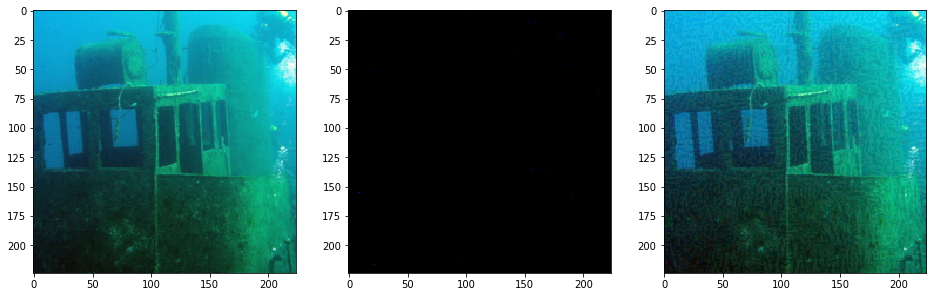

using model type: s

Original image predictions:
wreck (913): 0.9830995202064514
scuba diver (983): 0.014885143376886845
electric ray, crampfish, numbfish, torpedo (5): 0.0002842579851858318
sea lion (150): 0.00017907933215610683
stingray (6): 0.00015808157331775874

Generating adversarial example
L2: 38.79452

Adversarial image predictions:
scuba diver (983): 0.672141969203949
projector (745): 0.07301923632621765
stage (819): 0.01986122317612171
dugong, Dugong dugon (149): 0.016262322664260864
coral reef (973): 0.01061786524951458


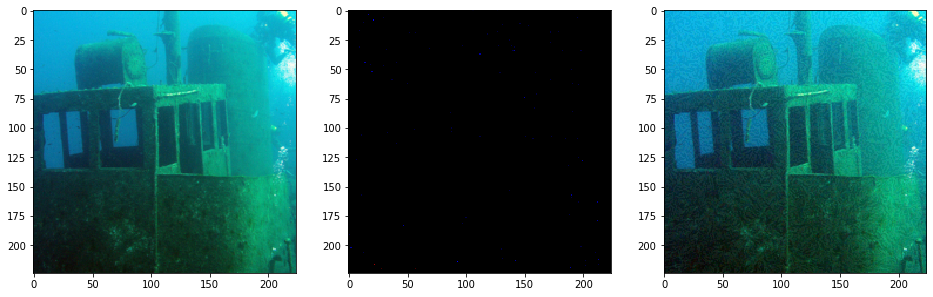

mortarboard
using model type: z

Original image predictions:
chow, chow chow (260): 0.6193305850028992
Pomeranian (259): 0.3760802745819092
Pekinese, Pekingese, Peke (154): 0.0022553810849785805
Persian cat (283): 0.0008024511043913662
Brabancon griffon (262): 0.00048131338553503156

Generating adversarial example
L2: 38.798004

Adversarial image predictions:
Pomeranian (259): 0.9993406534194946
papillon (157): 0.00041046913247555494
Pekinese, Pekingese, Peke (154): 0.00010912588913924992
Chihuahua (151): 7.037987234070897e-05
guinea pig, Cavia cobaya (338): 3.0212037017918192e-05


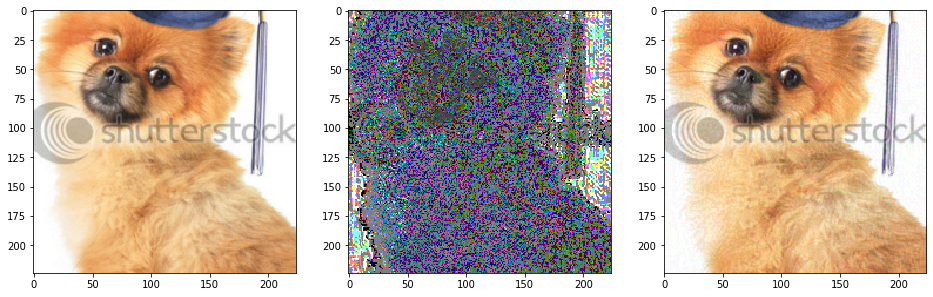

using model type: s

Original image predictions:
Pomeranian (259): 0.6610918641090393
chow, chow chow (260): 0.17304657399654388
Pekinese, Pekingese, Peke (154): 0.10974487662315369
Brabancon griffon (262): 0.017978891730308533
Persian cat (283): 0.011899187229573727

Generating adversarial example
L2: 38.798004

Adversarial image predictions:
chow, chow chow (260): 0.565109372138977
Brabancon griffon (262): 0.05799127370119095
pug, pug-dog (254): 0.05219346657395363
teddy, teddy bear (850): 0.039569590240716934
bath towel (434): 0.03100392408668995


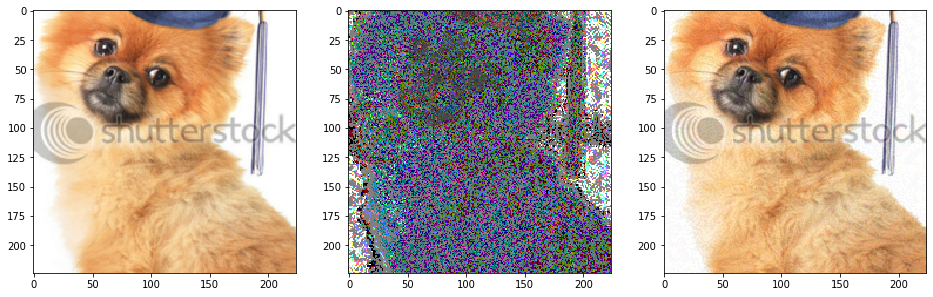

wallaby, brush kangaroo
using model type: z

Original image predictions:
wallaby, brush kangaroo (104): 0.41934293508529663
dhole, Cuon alpinus (274): 0.12568679451942444
cougar, puma, catamount, mountain lion, painter, panther, Felis concolor (286): 0.0881086215376854
weasel (356): 0.05573632940649986
mongoose (298): 0.05094868689775467

Generating adversarial example
L2: 38.780373

Adversarial image predictions:
tiger, Panthera tigris (292): 0.17767983675003052
lion, king of beasts, Panthera leo (291): 0.10929888486862183
cougar, puma, catamount, mountain lion, painter, panther, Felis concolor (286): 0.08950549364089966
diamondback, diamondback rattlesnake, Crotalus adamanteus (67): 0.07441490143537521
sidewinder, horned rattlesnake, Crotalus cerastes (68): 0.071381576359272


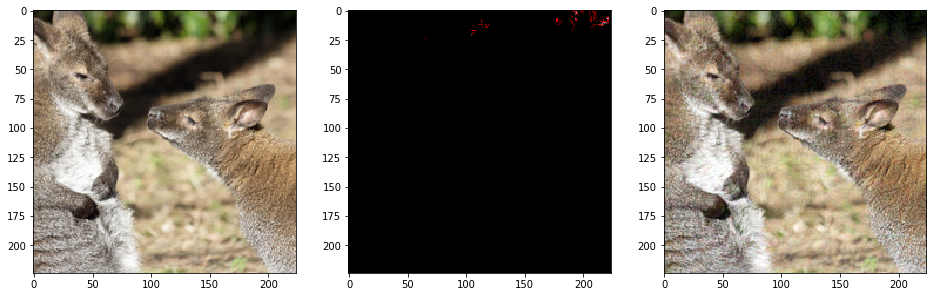

using model type: s

Original image predictions:
wallaby, brush kangaroo (104): 0.9994553923606873
coyote, prairie wolf, brush wolf, Canis latrans (272): 0.00020985363516956568
red wolf, maned wolf, Canis rufus, Canis niger (271): 6.853719241917133e-05
mongoose (298): 5.881683682673611e-05
dhole, Cuon alpinus (274): 4.5783279347233474e-05

Generating adversarial example
L2: 38.777702

Adversarial image predictions:
coyote, prairie wolf, brush wolf, Canis latrans (272): 0.33003613352775574
common iguana, iguana, Iguana iguana (39): 0.32218092679977417
frilled lizard, Chlamydosaurus kingi (43): 0.09249169379472733
timber wolf, grey wolf, gray wolf, Canis lupus (269): 0.035022590309381485
lynx, catamount (287): 0.030448181554675102


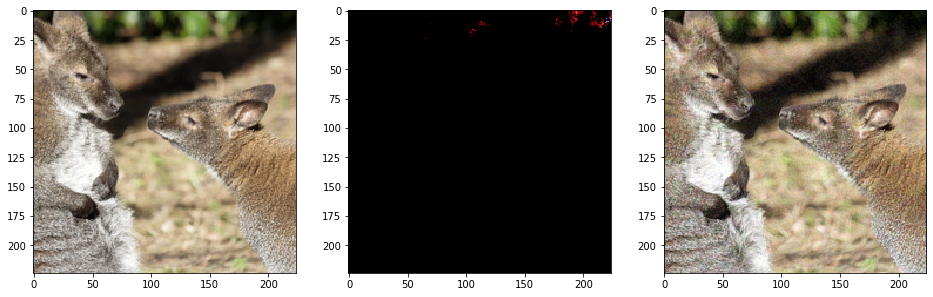

black and gold garden spider, Argiope aurantia
using model type: z

Original image predictions:
black and gold garden spider, Argiope aurantia (72): 0.4547470211982727
garden spider, Aranea diademata (74): 0.3843630254268646
barn spider, Araneus cavaticus (73): 0.07410214841365814
black widow, Latrodectus mactans (75): 0.06352441012859344
spider web, spider's web (815): 0.008009782060980797

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
black widow, Latrodectus mactans (75): 0.3274431824684143
wolf spider, hunting spider (77): 0.24007990956306458
barn spider, Araneus cavaticus (73): 0.13821831345558167
tarantula (76): 0.08849650621414185
ant, emmet, pismire (310): 0.07131566852331161


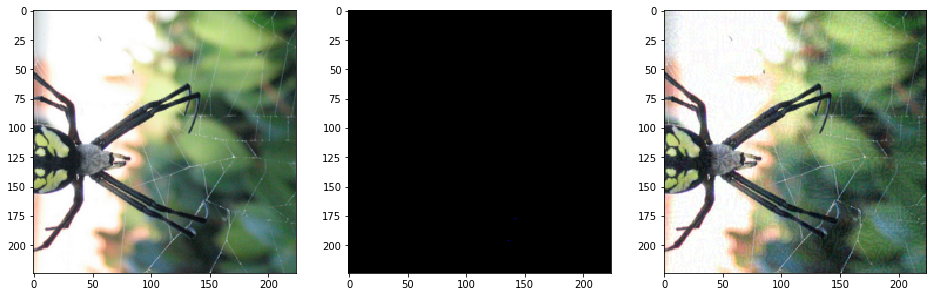

using model type: s

Original image predictions:
black and gold garden spider, Argiope aurantia (72): 0.7566907405853271
garden spider, Aranea diademata (74): 0.19640949368476868
barn spider, Araneus cavaticus (73): 0.0221484936773777
black widow, Latrodectus mactans (75): 0.018816787749528885
spider web, spider's web (815): 0.004046543966978788

Generating adversarial example
L2: 38.79795

Adversarial image predictions:
black widow, Latrodectus mactans (75): 0.6502736806869507
wolf spider, hunting spider (77): 0.11305667459964752
garden spider, Aranea diademata (74): 0.07085094600915909
barn spider, Araneus cavaticus (73): 0.06468461453914642
tarantula (76): 0.034459855407476425


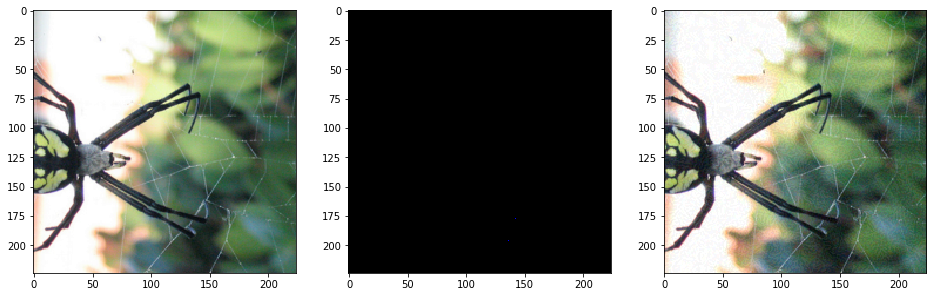

schipperke
using model type: z

Original image predictions:
schipperke (223): 0.9079154133796692
groenendael (224): 0.03233804926276207
Staffordshire bullterrier, Staffordshire bull terrier (179): 0.010808414779603481
malinois (225): 0.009546737186610699
kelpie (227): 0.007869898341596127

Generating adversarial example
L2: 38.787247

Adversarial image predictions:
wallaby, brush kangaroo (104): 0.11568944156169891
peacock (84): 0.0440865084528923
sundial (835): 0.03224541246891022
triceratops (51): 0.03083200193941593
Gordon setter (214): 0.026146624237298965


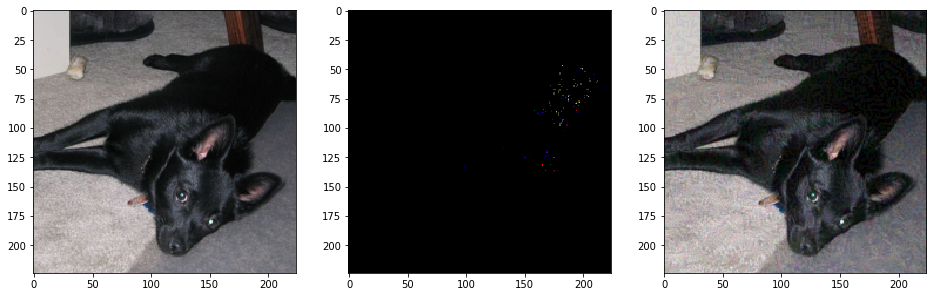

using model type: s

Original image predictions:
schipperke (223): 0.9543586373329163
kelpie (227): 0.022785115987062454
groenendael (224): 0.013394027017056942
flat-coated retriever (205): 0.003490770235657692
Labrador retriever (208): 0.0018493094248697162

Generating adversarial example
L2: 38.787045

Adversarial image predictions:
Scotch terrier, Scottish terrier, Scottie (199): 0.7474752068519592
kelpie (227): 0.03434227034449577
giant schnauzer (197): 0.032413091510534286
malinois (225): 0.031921133399009705
German shepherd, German shepherd dog, German police dog, alsatian (235): 0.028965406119823456


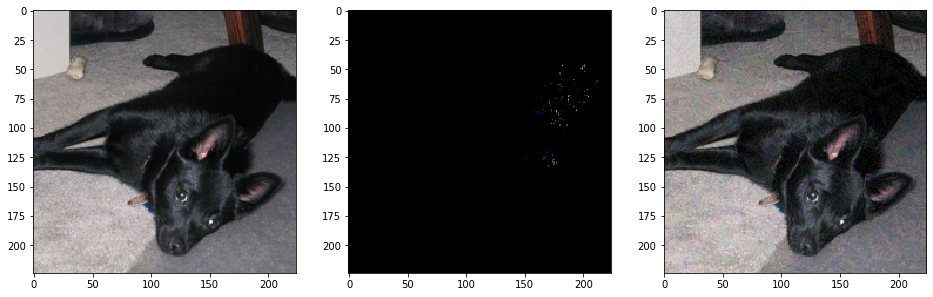

Mexican hairless
using model type: z

Original image predictions:
Mexican hairless (268): 0.19443699717521667
American Staffordshire terrier, Staffordshire terrier, American pit bull terrier, pit bull terrier (180): 0.18643693625926971
hippopotamus, hippo, river horse, Hippopotamus amphibius (344): 0.17298829555511475
wallaby, brush kangaroo (104): 0.12444299459457397
water buffalo, water ox, Asiatic buffalo, Bubalus bubalis (346): 0.07019151002168655

Generating adversarial example
L2: 38.698196

Adversarial image predictions:
baboon (372): 0.5063247084617615
hippopotamus, hippo, river horse, Hippopotamus amphibius (344): 0.16905657947063446
wallaby, brush kangaroo (104): 0.11600984632968903
Komodo dragon, Komodo lizard, dragon lizard, giant lizard, Varanus komodoensis (48): 0.03495766967535019
mongoose (298): 0.02358522266149521


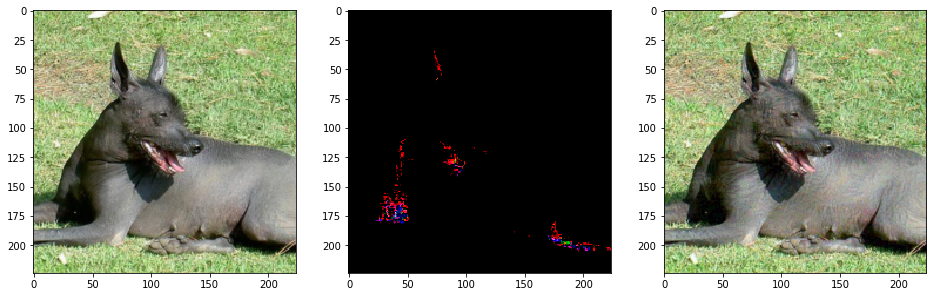

using model type: s

Original image predictions:
Mexican hairless (268): 0.9416741728782654
malinois (225): 0.008846352808177471
wallaby, brush kangaroo (104): 0.007133547682315111
kelpie (227): 0.005040461663156748
Scotch terrier, Scottish terrier, Scottie (199): 0.004327631555497646

Generating adversarial example
L2: 38.702976

Adversarial image predictions:
groenendael (224): 0.4893323481082916
German shepherd, German shepherd dog, German police dog, alsatian (235): 0.22379712760448456
malinois (225): 0.04737706109881401
kelpie (227): 0.03862465173006058
schipperke (223): 0.028427470475435257


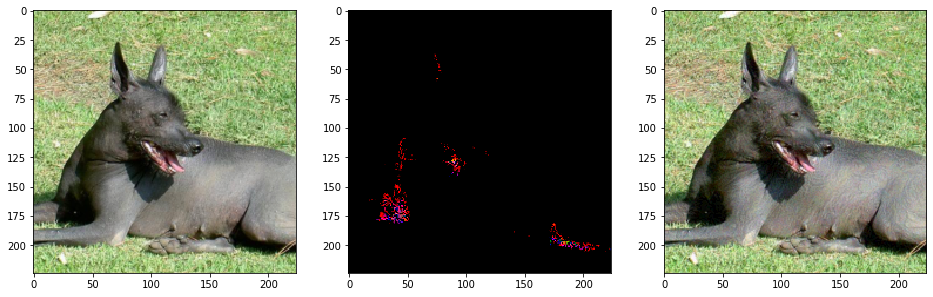

Persian cat
using model type: z

Original image predictions:
Persian cat (283): 0.1814778596162796
toy poodle (265): 0.14894117414951324
Maltese dog, Maltese terrier, Maltese (153): 0.11813472956418991
Pomeranian (259): 0.11219298839569092
West Highland white terrier (203): 0.05356505513191223

Generating adversarial example
L2: 38.798008

Adversarial image predictions:
West Highland white terrier (203): 0.5341928005218506
Lakeland terrier (189): 0.1169397160410881
Irish terrier (184): 0.04208633303642273
Airedale, Airedale terrier (191): 0.0420665517449379
miniature poodle (266): 0.03088274598121643


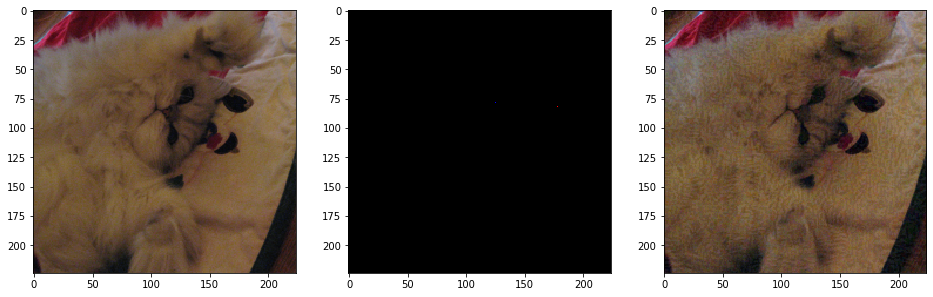

using model type: s

Original image predictions:
Persian cat (283): 0.3969525694847107
Pomeranian (259): 0.2753588557243347
Angora, Angora rabbit (332): 0.13269644975662231
toy poodle (265): 0.044400542974472046
teddy, teddy bear (850): 0.01945592649281025

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
toy poodle (265): 0.2989298105239868
miniature poodle (266): 0.10833274573087692
teddy, teddy bear (850): 0.09413530677556992
West Highland white terrier (203): 0.07080812007188797
Scotch terrier, Scottish terrier, Scottie (199): 0.05771275982260704


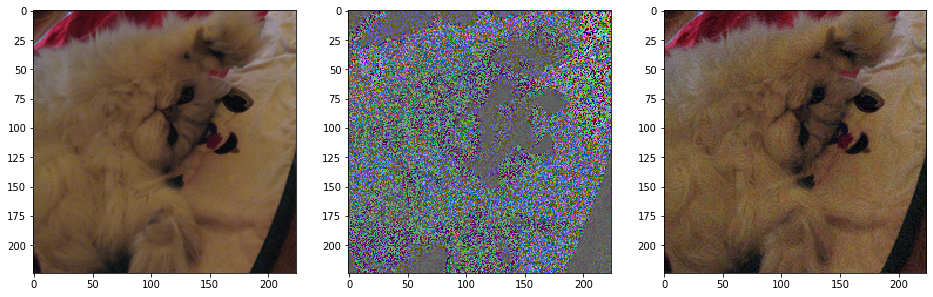

carpenter's kit, tool kit
using model type: z

Original image predictions:
cellular telephone, cellular phone, cellphone, cell, mobile phone (487): 0.35420703887939453
remote control, remote (761): 0.27285099029541016
carpenter's kit, tool kit (477): 0.0589812695980072
notebook, notebook computer (681): 0.05083863437175751
modem (662): 0.04041922464966774

Generating adversarial example
L2: 38.798042

Adversarial image predictions:
carpenter's kit, tool kit (477): 0.5336018800735474
wallet, billfold, notecase, pocketbook (893): 0.05555657669901848
pencil box, pencil case (709): 0.02945830300450325
remote control, remote (761): 0.027200471609830856
modem (662): 0.022294113412499428


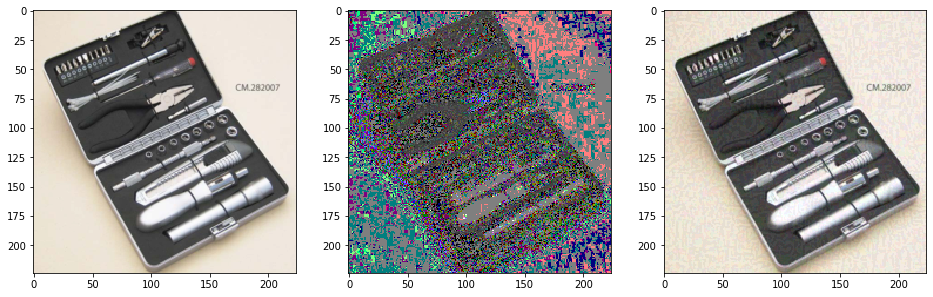

using model type: s

Original image predictions:
carpenter's kit, tool kit (477): 0.7504392266273499
screwdriver (784): 0.08908248692750931
tape player (848): 0.03375139459967613
cassette player (482): 0.020807279273867607
remote control, remote (761): 0.01879754289984703

Generating adversarial example
L2: 38.798042

Adversarial image predictions:
cassette player (482): 0.4675670266151428
tape player (848): 0.3508748412132263
CD player (485): 0.062039315700531006
remote control, remote (761): 0.05242900922894478
cassette (481): 0.0410732701420784


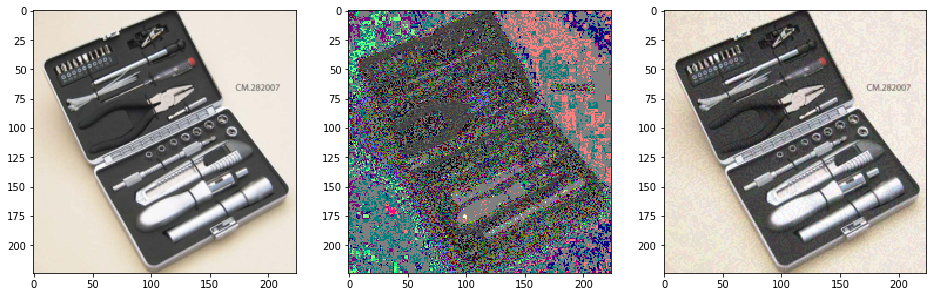

ringneck snake, ring-necked snake, ring snake
using model type: z

Original image predictions:
ringneck snake, ring-necked snake, ring snake (53): 0.5611066818237305
thunder snake, worm snake, Carphophis amoenus (52): 0.21083644032478333
common newt, Triturus vulgaris (26): 0.12066328525543213
eft (27): 0.030134249478578568
starfish, sea star (327): 0.027912024408578873

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
common newt, Triturus vulgaris (26): 0.3449332118034363
thunder snake, worm snake, Carphophis amoenus (52): 0.12137370556592941
starfish, sea star (327): 0.07448969036340714
African chameleon, Chamaeleo chamaeleon (47): 0.05885537713766098
eft (27): 0.055395860224962234


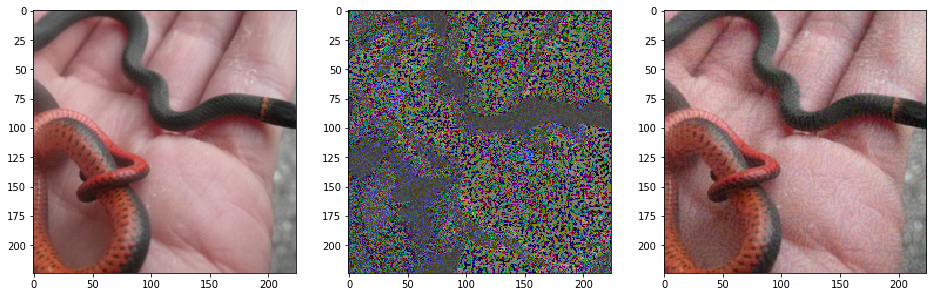

using model type: s

Original image predictions:
ringneck snake, ring-necked snake, ring snake (53): 0.9624211192131042
thunder snake, worm snake, Carphophis amoenus (52): 0.03390078246593475
night snake, Hypsiglena torquata (60): 0.0018551620887592435
water snake (58): 0.0008182841120287776
king snake, kingsnake (56): 0.00045417112414725125

Generating adversarial example
L2: 38.79807

Adversarial image predictions:
thunder snake, worm snake, Carphophis amoenus (52): 0.7678895592689514
water snake (58): 0.08742114156484604
night snake, Hypsiglena torquata (60): 0.042995426803827286
nematode, nematode worm, roundworm (111): 0.04017414525151253
ringneck snake, ring-necked snake, ring snake (53): 0.016792574897408485


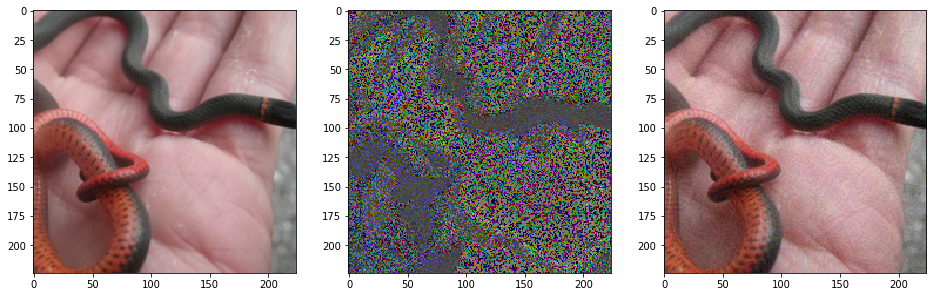

bulletproof vest
using model type: z

Original image predictions:
bulletproof vest (465): 0.35091015696525574
assault rifle, assault gun (413): 0.2699357569217682
military uniform (652): 0.17211653292179108
holster (597): 0.043689657002687454
knee pad (615): 0.032085955142974854

Generating adversarial example
L2: 38.79789

Adversarial image predictions:
assault rifle, assault gun (413): 0.8727884292602539
rifle (764): 0.0328247956931591
military uniform (652): 0.02212601527571678
holster (597): 0.019656268879771233
projectile, missile (744): 0.0032795898150652647


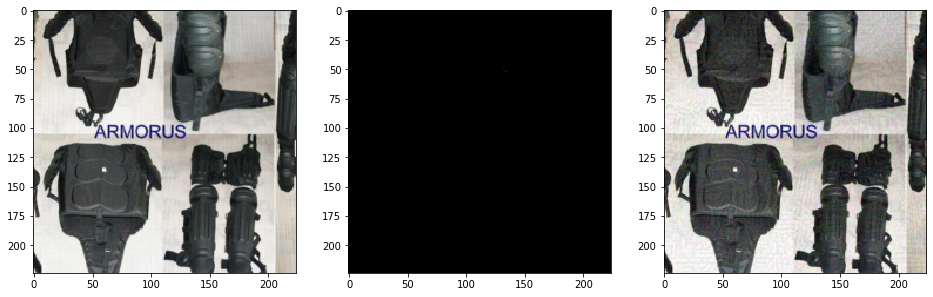

using model type: s

Original image predictions:
knee pad (615): 0.6641526818275452
backpack, back pack, knapsack, packsack, rucksack, haversack (414): 0.12001966685056686
oxygen mask (691): 0.11094310879707336
bulletproof vest (465): 0.032872311770915985
tripod (872): 0.019200434908270836

Generating adversarial example
L2: 38.797894

Adversarial image predictions:
oxygen mask (691): 0.23032937943935394
assault rifle, assault gun (413): 0.10690256953239441
stretcher (830): 0.08941666781902313
trench coat (869): 0.06542252749204636
corkscrew, bottle screw (512): 0.04513504356145859


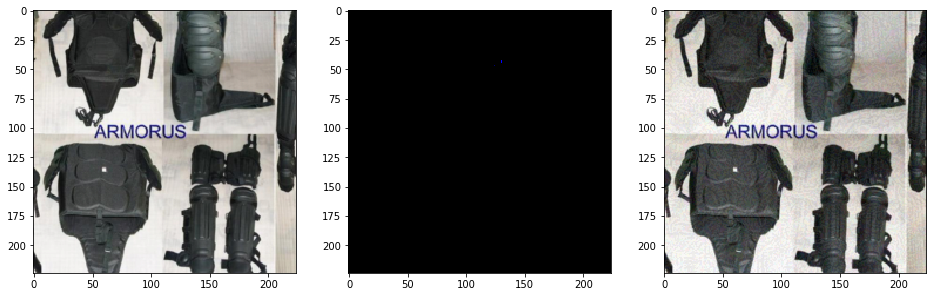

black swan, Cygnus atratus
using model type: z

Original image predictions:
black swan, Cygnus atratus (100): 0.9991319179534912
hen (8): 0.0002605027984827757
vulture (23): 0.00023821560898795724
curly-coated retriever (206): 9.986430814024061e-05
goose (99): 7.305992039619014e-05

Generating adversarial example
L2: 38.079685

Adversarial image predictions:
vulture (23): 0.42808762192726135
hen (8): 0.3162175416946411
cock (7): 0.07797824591398239
plow, plough (730): 0.037425898015499115
ostrich, Struthio camelus (9): 0.009717278182506561


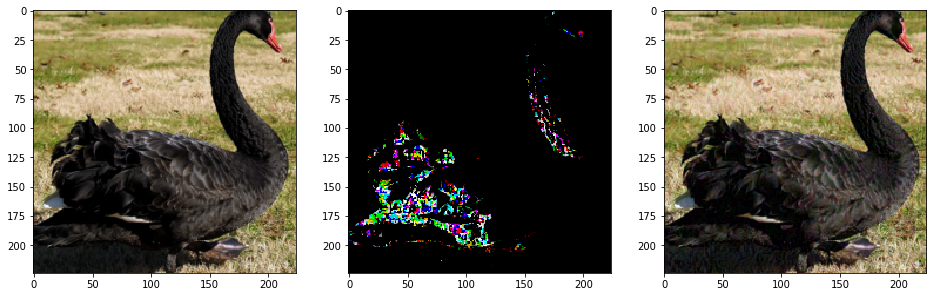

using model type: s

Original image predictions:
black swan, Cygnus atratus (100): 0.9998391270637512
goose (99): 0.00010564715921645984
hen (8): 3.2781503250589594e-05
ostrich, Struthio camelus (9): 5.4303327488014475e-06
drake (97): 3.283783826191211e-06

Generating adversarial example
L2: 38.089012

Adversarial image predictions:
goose (99): 0.09932612627744675
hen (8): 0.06002870202064514
black swan, Cygnus atratus (100): 0.05603476241230965
partridge (86): 0.05496290326118469
quail (85): 0.035372089594602585


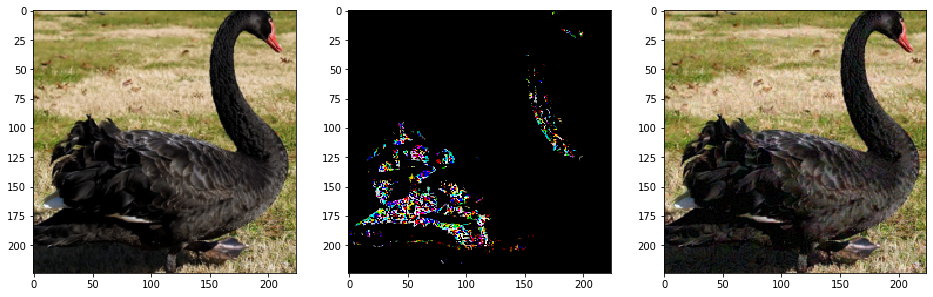

dumbbell
using model type: z

Original image predictions:
plane, carpenter's plane, woodworking plane (726): 0.23825857043266296
dumbbell (543): 0.11789267510175705
cleaver, meat cleaver, chopper (499): 0.041897449642419815
notebook, notebook computer (681): 0.02991722710430622
harmonica, mouth organ, harp, mouth harp (593): 0.023849908262491226

Generating adversarial example
L2: 38.7944

Adversarial image predictions:
sock (806): 0.09546354413032532
cardigan (474): 0.06126473471522331
wool, woolen, woollen (911): 0.042655378580093384
jackfruit, jak, jack (955): 0.030791670083999634
mitten (658): 0.02746652066707611


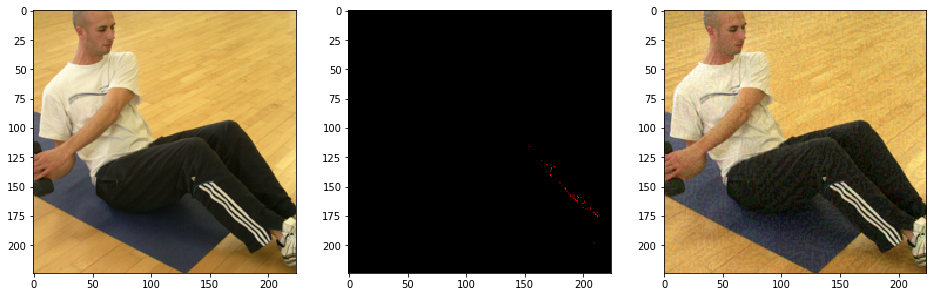

using model type: s

Original image predictions:
racket, racquet (752): 0.1786733865737915
volleyball (890): 0.15792401134967804
dumbbell (543): 0.05153464153409004
parallel bars, bars (702): 0.040560077875852585
basketball (430): 0.04010552912950516

Generating adversarial example
L2: 38.79324

Adversarial image predictions:
miniskirt, mini (655): 0.03853991627693176
studio couch, day bed (831): 0.03243622928857803
Italian greyhound (171): 0.027501529082655907
Shetland sheepdog, Shetland sheep dog, Shetland (230): 0.022627968341112137
basenji (253): 0.021524302661418915


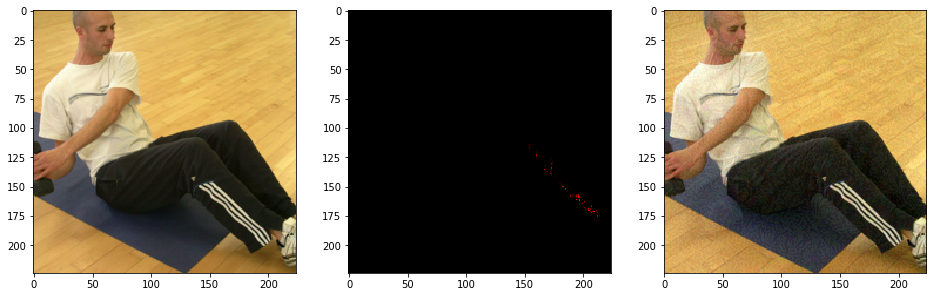

bittern
using model type: z

Original image predictions:
bittern (133): 0.9831421375274658
crane (134): 0.0013992462772876024
warthog (343): 0.0009681394440121949
ostrich, Struthio camelus (9): 0.000922350853215903
bustard (138): 0.0008832530002109706

Generating adversarial example
L2: 38.560093

Adversarial image predictions:
Irish wolfhound (170): 0.6610341668128967
soft-coated wheaten terrier (202): 0.04798531532287598
Scottish deerhound, deerhound (177): 0.03981470316648483
warthog (343): 0.03502551093697548
Lakeland terrier (189): 0.02428217977285385


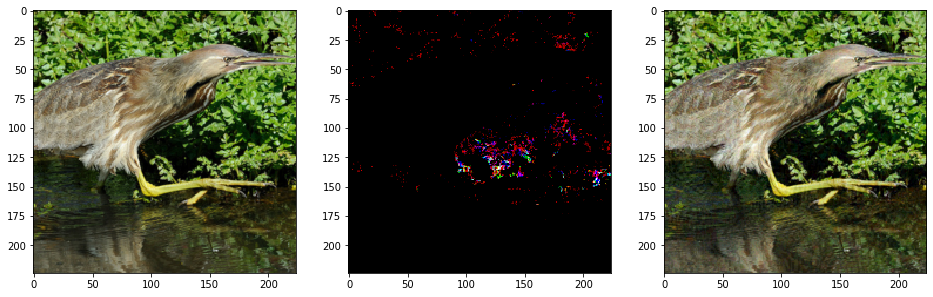

using model type: s

Original image predictions:
bittern (133): 0.9999157190322876
little blue heron, Egretta caerulea (131): 5.936287925578654e-05
bustard (138): 8.081905434664804e-06
limpkin, Aramus pictus (135): 5.302027602738235e-06
American egret, great white heron, Egretta albus (132): 3.914715762221022e-06

Generating adversarial example
L2: 38.55898

Adversarial image predictions:
little blue heron, Egretta caerulea (131): 0.583390474319458
crane (134): 0.0576457642018795
limpkin, Aramus pictus (135): 0.04327685385942459
European gallinule, Porphyrio porphyrio (136): 0.031083162873983383
American egret, great white heron, Egretta albus (132): 0.024988291785120964


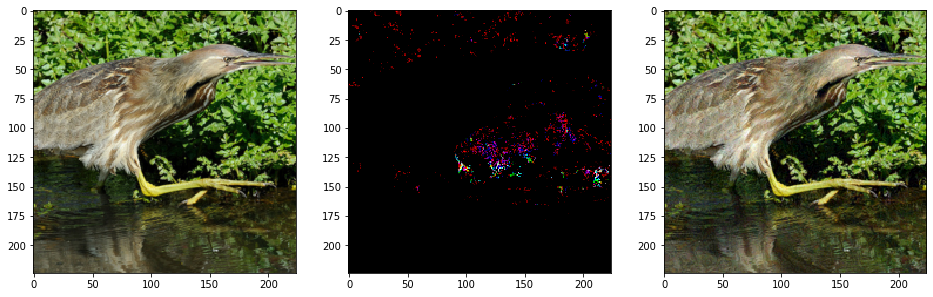

Rhodesian ridgeback
using model type: z

Original image predictions:
Border terrier (182): 0.11416804790496826
malinois (225): 0.09822257608175278
Rhodesian ridgeback (159): 0.0782012790441513
Chesapeake Bay retriever (209): 0.06137491390109062
German shepherd, German shepherd dog, German police dog, alsatian (235): 0.0540948249399662

Generating adversarial example
L2: 38.79806

Adversarial image predictions:
Rhodesian ridgeback (159): 0.21105211973190308
vizsla, Hungarian pointer (211): 0.12763170897960663
ram, tup (348): 0.08072039484977722
Italian greyhound (171): 0.048521481454372406
bighorn, bighorn sheep, cimarron, Rocky Mountain bighorn, Rocky Mountain sheep, Ovis canadensis (349): 0.046975430101156235


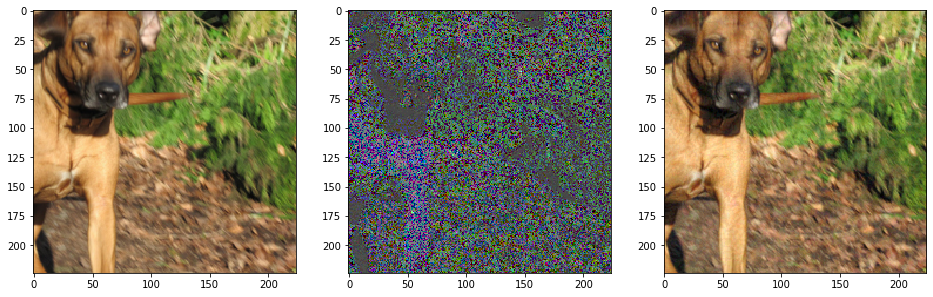

using model type: s

Original image predictions:
Rhodesian ridgeback (159): 0.8939680457115173
Great Dane (246): 0.0430111289024353
malinois (225): 0.02796442247927189
bull mastiff (243): 0.014192170463502407
bloodhound, sleuthhound (163): 0.005042097065597773

Generating adversarial example
L2: 38.79806

Adversarial image predictions:
German shepherd, German shepherd dog, German police dog, alsatian (235): 0.7239260077476501
briard (226): 0.0633465051651001
Irish wolfhound (170): 0.0463210791349411
malinois (225): 0.041051629930734634
Great Dane (246): 0.023047100752592087


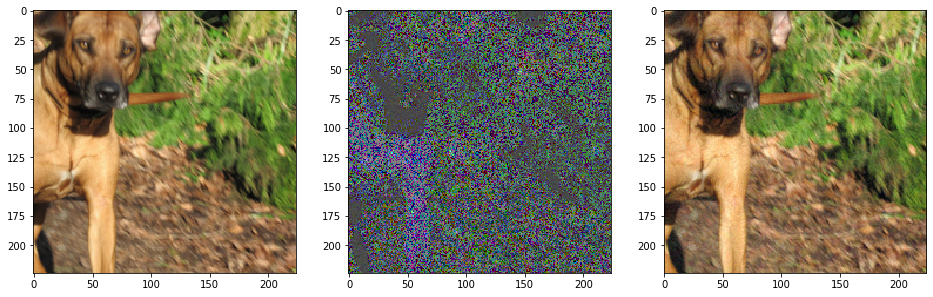

bearskin, busby, shako
using model type: z

Original image predictions:
cannon (471): 0.13870671391487122
bearskin, busby, shako (439): 0.11099511384963989
ballplayer, baseball player (981): 0.10370736569166183
king penguin, Aptenodytes patagonica (145): 0.10018368065357208
Old English sheepdog, bobtail (229): 0.05073300749063492

Generating adversarial example
L2: 38.798058

Adversarial image predictions:
Old English sheepdog, bobtail (229): 0.18715724349021912
Newfoundland, Newfoundland dog (256): 0.16747573018074036
EntleBucher (241): 0.12125082314014435
king penguin, Aptenodytes patagonica (145): 0.11549936234951019
Leonberg (255): 0.08868557214736938


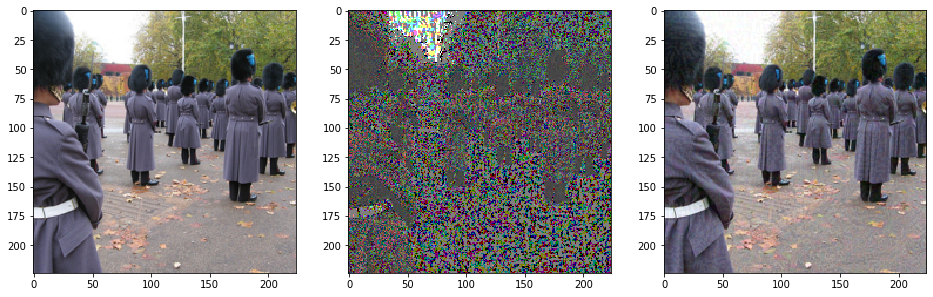

using model type: s

Original image predictions:
bearskin, busby, shako (439): 0.8966743350028992
military uniform (652): 0.04437486082315445
academic gown, academic robe, judge's robe (400): 0.023357339203357697
bow (456): 0.012163477949798107
mortarboard (667): 0.0057717119343578815

Generating adversarial example
L2: 38.798058

Adversarial image predictions:
mortarboard (667): 0.26226547360420227
academic gown, academic robe, judge's robe (400): 0.23458239436149597
maypole (645): 0.07734710723161697
vestment (887): 0.06530943512916565
bow (456): 0.06241559609770775


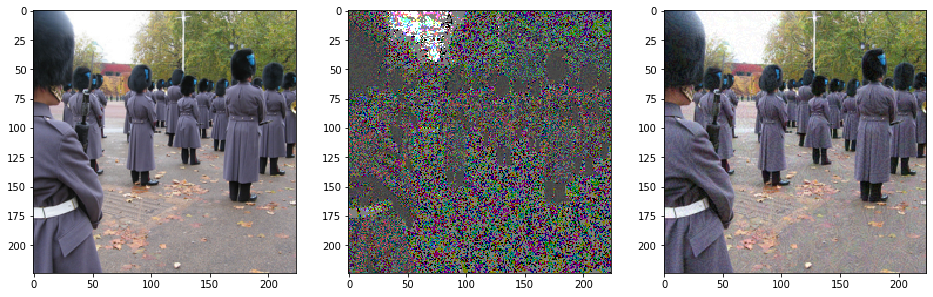

Chihuahua
using model type: z

Original image predictions:
Chihuahua (151): 0.9682992696762085
French bulldog (245): 0.00611417181789875
toy poodle (265): 0.005874409805983305
custard apple (956): 0.00396569911390543
miniature poodle (266): 0.0039640432223677635

Generating adversarial example
L2: 38.78652

Adversarial image predictions:
custard apple (956): 0.8658141493797302
teddy, teddy bear (850): 0.03677743300795555
miniature poodle (266): 0.0271776020526886
corn (987): 0.009791684336960316
jackfruit, jak, jack (955): 0.0072622946463525295


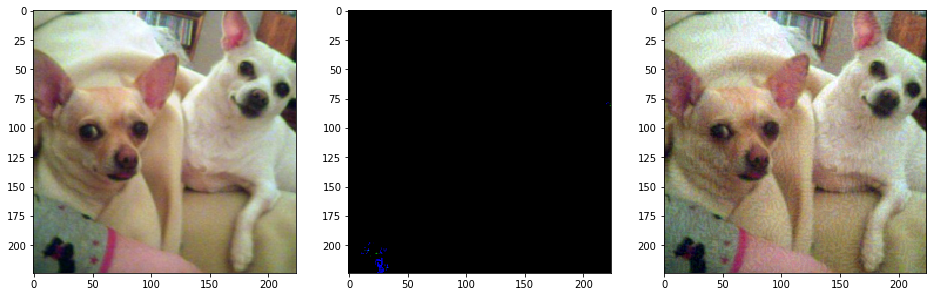

using model type: s

Original image predictions:
Chihuahua (151): 0.9997713565826416
French bulldog (245): 0.00012632702419068664
toy terrier (158): 9.695865446701646e-05
miniature pinscher (237): 4.326005182520021e-06
Boston bull, Boston terrier (195): 1.8339035534609138e-07

Generating adversarial example
L2: 38.788628

Adversarial image predictions:
French bulldog (245): 0.996505618095398
pug, pug-dog (254): 0.0009299350203946233
boxer (242): 0.0007215000223368406
soccer ball (805): 0.0005625246558338404
Boston bull, Boston terrier (195): 0.00028706021839752793


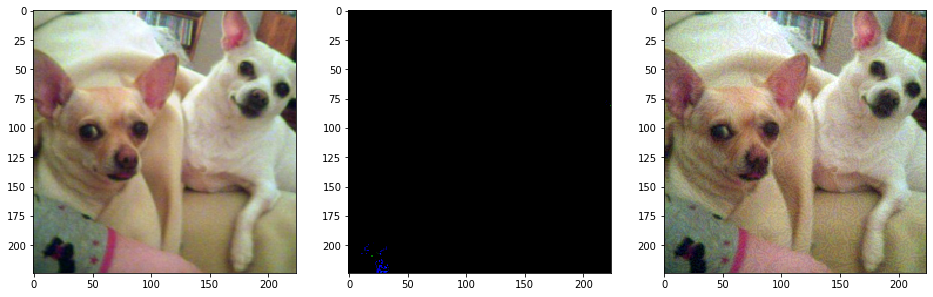

llama
using model type: z

Original image predictions:
llama (355): 0.5597620606422424
Arabian camel, dromedary, Camelus dromedarius (354): 0.07291088998317719
ox (345): 0.06983509659767151
bison (347): 0.05313686281442642
Tibetan mastiff (244): 0.04144851863384247

Generating adversarial example
L2: 38.674934

Adversarial image predictions:
Chesapeake Bay retriever (209): 0.2971944212913513
ox (345): 0.208701953291893
bison (347): 0.08860346674919128
curly-coated retriever (206): 0.07134468853473663
hog, pig, grunter, squealer, Sus scrofa (341): 0.062034185975790024


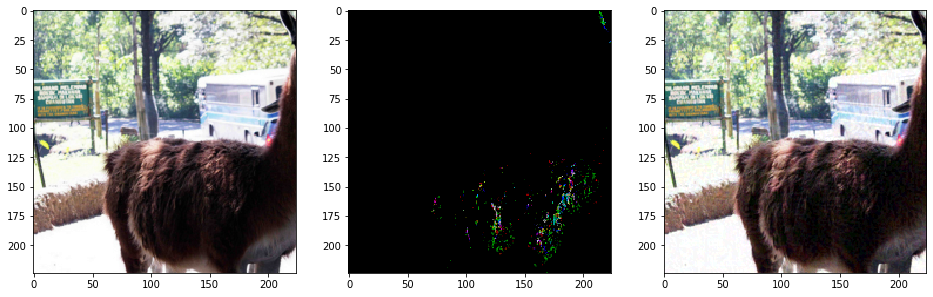

using model type: s

Original image predictions:
llama (355): 0.995690643787384
ostrich, Struthio camelus (9): 0.0016515350434929132
Arabian camel, dromedary, Camelus dromedarius (354): 0.0002851148310583085
ox (345): 0.00023085901921149343
hay (958): 0.0001622542622499168

Generating adversarial example
L2: 38.662952

Adversarial image predictions:
ostrich, Struthio camelus (9): 0.019741445779800415
tiger cat (282): 0.01849907822906971
tabby, tabby cat (281): 0.016155391931533813
wombat (106): 0.012521492317318916
swing (843): 0.01191031001508236


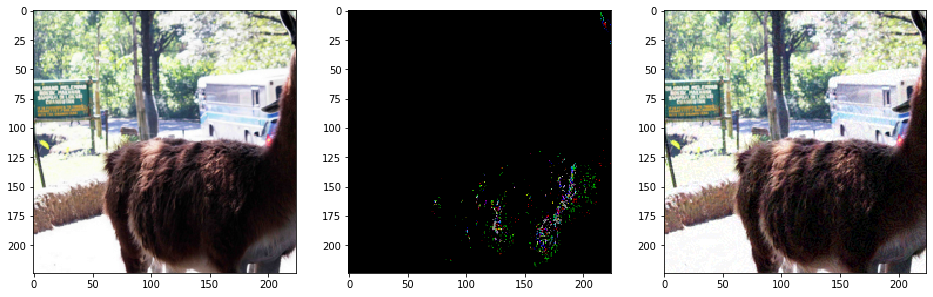

In [11]:
for i in range(1000, 1050):
    im = Image.open(fnames[i]).convert('RGB')
    print(labels[y_val[i]])
    perform_attack(im, 'z', eps=0.15)
    perform_attack(im, 's', eps=0.15)